# ML model development based on the global COVID-19 forecasting dataset

### Description of Project: 

#### As the result of the effort of the White House Office of Science and Technology Policy (OSTP) working together with coalition research groups and companies (including Kaggle) to prepare the COVID-19 Open Research Dataset (CORD-19) in order to address key open scientific questions on COVID-19, Kaggle launched a companion COVID-19 forecasting challenges to help answer a subset of those questions.
#### On the basis of the Kaggle’s challenge, in this project, your team is challenged to develop a ML model to  predict the cumulative number of COVID19 confirmed cases and the number of resulting fatalities across the world, and is accurate in forecasting for future days. For the forecasting task, quantile estimates of the confirmed cases and fatalities are calculated based on the outcome of the predictive model you developed using the standard metric called Weighted Pinball Loss defined by Kaggle. The goal of this challenge is to provide better methods for estimates that can assist medical and governmental institutions to prepare and adjust as pandemics unfold.


#### Data Dictionary:  
   * ID: Unique identifier
   * County: County of specific country like US
   * Province_state: the province or state within a country where the data is reported (if applicable)
   * Country_region: Countries as Germany, France or Spain
   * Weight: A weight assigned to the row, used for calculating the final score in the competition
   * Date: Datestamp for the respective row
   * Target: Placeholder whether confirmed cases or fatalities
   * TargetValue: Respective confirmed cases or Fatalities count (Target value for prediction and forecast)

## Installing specific analysis packages 

In [33]:
!pip install dataprep

  Created wheel for metaphone: filename=Metaphone-0.6-py3-none-any.whl size=13918 sha256=41a0e8906fe8239900bda76cc9b259673026d6c660040153e932e1d13c0a3f88
  Stored in directory: c:\users\aneesha\appdata\local\pip\cache\wheels\b2\9e\d9\26be7687b8fe36cd6cacbec34e825a3dbcd3bae54017cfb385
Successfully built metaphone
  Attempting uninstall: MarkupSafe
    Found existing installation: MarkupSafe 2.0.1
    Uninstalling MarkupSafe-2.0.1:
      Successfully uninstalled MarkupSafe-2.0.1
  Attempting uninstall: jinja2
    Found existing installation: Jinja2 2.11.3
    Uninstalling Jinja2-2.11.3:
      Successfully uninstalled Jinja2-2.11.3
  Attempting uninstall: Werkzeug
    Found existing installation: Werkzeug 2.0.3
    Uninstalling Werkzeug-2.0.3:
      Successfully uninstalled Werkzeug-2.0.3
  Attempting uninstall: regex
    Found existing installation: regex 2022.3.15
    Uninstalling regex-2022.3.15:
      Successfully uninstalled regex-2022.3.15
  Attempting uninstall: flask
    Found exi

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pandas-profiling 3.6.2 requires scipy<1.10,>=1.4.1, but you have scipy 1.10.0 which is incompatible.
jupyter-server 1.13.5 requires pywinpty<2; os_name == "nt", but you have pywinpty 2.0.2 which is incompatible.
distributed 2022.2.1 requires dask==2022.02.1, but you have dask 2023.1.0 which is incompatible.


In [2]:
!pip install pmdarima

In [74]:
!pip install plotly

In [95]:
!pip install dataprep

     ---------------------------------------- 9.9/9.9 MB 2.4 MB/s eta 0:00:00
     ---------------------------------------- 1.2/1.2 MB 39.5 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 2.1/2.1 MB 34.3 MB/s eta 0:00:00
     ---------------------------------------- 158.6/158.6 kB ? eta 0:00:00
     ---------------------------------------- 133.6/133.6 kB ? eta 0:00:00
     ---------------------------------------- 1.0/1.0 MB 33.1 MB/s eta 0:00:00
     ------------------------------------- 273.3/273.3 kB 17.5 MB/s eta 0:00:00
     -------------------------------------- 101.5/101.5 kB 5.7 MB/s eta 0:00:00
     ---------------------------------------- 153.1/153.1 kB ? eta 0:00:00
     ------------------------------------- 323.5/323.5 kB 19.6 MB/s eta 0:00:00
     ---------------------------------------- 1.0/1.0 MB 7.1 MB/s eta 0:00:00
     -----------------------------------

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
anaconda-project 0.11.1 requires ruamel-yaml, which is not installed.


### Import required libraries

In [96]:
# Required Libraries
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import plotly.graph_objects as go

#default theme
sns.set(context='notebook', style='darkgrid', palette='Spectral', font='sans-serif', font_scale=1, rc=None)
matplotlib.rcParams['figure.figsize'] =[8,8]
matplotlib.rcParams.update({'font.size': 15})
matplotlib.rcParams['font.family'] = 'sans-serif'

pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

plt.rcParams['figure.figsize'] = 10, 12

matplotlib.rcParams['figure.figsize'] =[8,8]
matplotlib.rcParams.update({'font.size': 15})
matplotlib.rcParams['font.family'] = 'sans-serif'


from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
import xgboost as xgb
import lightgbm as ltb
from lightgbm import LGBMRegressor
from sklearn.pipeline import Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder,StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
import itertools

# Timeseries
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
#from pmdarima import auto_arima
import statsmodels.api as sm

from math import sqrt

# dataprep library
from dataprep.eda import *

%matplotlib inline

# Ignore warnings 
import warnings
warnings.filterwarnings('ignore') 

np.random.seed(614)

### Loading the dataset

COVID19 Global Forecasting (Week 5) <br>
https://www.kaggle.com/competitions/covid19-global-forecasting-week-5/data <br>

In [97]:
# Read the dataset
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

# Keep a copy of the dataset for performing timeseries analysis
train_Timeseries=train.copy()
test_Timeseries=test.copy()

## Exploratory Data Analysis

### Check the size of the train dataset

In [159]:
train_Shape=train.shape
print('There are {} records and {} features in the training dataset.'.format(train_Shape[0],train_Shape[1]))

There are 969640 records and 9 features in the training dataset.


### Check the size of the test dataset

In [160]:
test_Shape=test.shape
print('There are {} records and {} features in the test dataset.'.format(test_Shape[0],test_Shape[1]))

There are 311670 records and 8 features in the test dataset.


### Display the top 10 records from the training dataset

In [161]:
train.head(10)

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0
4,5,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-25,ConfirmedCases,0
5,6,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-25,Fatalities,0
6,7,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-26,ConfirmedCases,0
7,8,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-26,Fatalities,0
8,9,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-27,ConfirmedCases,0
9,10,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-27,Fatalities,0


### Display the top 10 records from the test dataset

In [127]:
temp=train[~train['County'].isnull()]
temp['Country_Region'].unique()

array(['US'], dtype=object)

In [9]:
test.head(10)

,ForecastId,County,Province_State,Country_Region,Population,Weight,Date,Target
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-27,ConfirmedCases
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-27,Fatalities
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-28,ConfirmedCases
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-28,Fatalities
4,5,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-29,ConfirmedCases
5,6,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-29,Fatalities
6,7,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-30,ConfirmedCases
7,8,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-30,Fatalities
8,9,NaN,NaN,Afghanistan,27657145,0.058359,2020-05-01,ConfirmedCases
9,10,NaN,NaN,Afghanistan,27657145,0.583587,2020-05-01,Fatalities


### Display the last 10 records from the training dataset

In [10]:
train.tail(10)

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
969630,969631,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-06,ConfirmedCases,14
969631,969632,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-06,Fatalities,0
969632,969633,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-07,ConfirmedCases,3
969633,969634,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-07,Fatalities,0
969634,969635,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-08,ConfirmedCases,5
969635,969636,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-08,Fatalities,0
969636,969637,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-09,ConfirmedCases,27
969637,969638,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-09,Fatalities,0
969638,969639,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-10,ConfirmedCases,6
969639,969640,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-10,Fatalities,0


### Display the last 10 records from the test dataset

In [11]:
test.tail(10)

,ForecastId,County,Province_State,Country_Region,Population,Weight,Date,Target
311660,311661,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-06,ConfirmedCases
311661,311662,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-06,Fatalities
311662,311663,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-07,ConfirmedCases
311663,311664,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-07,Fatalities
311664,311665,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-08,ConfirmedCases
311665,311666,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-08,Fatalities
311666,311667,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-09,ConfirmedCases
311667,311668,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-09,Fatalities
311668,311669,NaN,NaN,Zimbabwe,14240168,0.060711,2020-06-10,ConfirmedCases
311669,311670,NaN,NaN,Zimbabwe,14240168,0.607106,2020-06-10,Fatalities


Observations:
  * There are 969640 records and 9 features in the training dataset.
  * There are 311670 records and 8 features in the test dataset.
  * The TargetValue column from test dataset is not available as we need to predict the results
  * Many null values are showing in county and Province_state column.We will explore futher to see if more columns have missing     values 


In [164]:
print("Data train -------------------------------------")
traindays = train['Date'].nunique()
print("Number of Country_Region: ", train['Country_Region'].nunique())
print("Number of Province_State: ", train['Province_State'].nunique())
notrain = train['Id'].nunique()
print("Number of datapoints in train:", notrain)


Data train -------------------------------------
Number of Country_Region:  187
Number of Province_State:  133
Number of datapoints in train: 969640


In [165]:
print("Datatest -------------------------------------")
testdays = test['Date'].nunique()
print("Number of Country_Region: ", test['Country_Region'].nunique())
print("Number of Province_State: ", test['Province_State'].nunique())
notest = test['ForecastId'].nunique()
print("Number of datapoints in test:", notest)

Datatest -------------------------------------
Number of Country_Region:  187
Number of Province_State:  133
Number of datapoints in test: 311670


### Check the datatypes of all features

In [166]:
# Check datatype of train dataset
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 969640 entries, 0 to 969639
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Id              969640 non-null  int64  
 1   County          880040 non-null  object 
 2   Province_State  917280 non-null  object 
 3   Country_Region  969640 non-null  object 
 4   Population      969640 non-null  int64  
 5   Weight          969640 non-null  float64
 6   Date            969640 non-null  object 
 7   Target          969640 non-null  object 
 8   TargetValue     969640 non-null  int64  
dtypes: float64(1), int64(3), object(5)
memory usage: 66.6+ MB


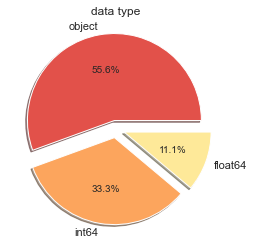

In [167]:
train.dtypes.value_counts().plot.pie(explode=[0.1,0.1,0.1],autopct='%1.1f%%',shadow=True)
plt.title('data type');

Observation:
 * Datatypes are int,float and object.Object columns need to be encoded to numerical columns before modelling

In [168]:
# Check datatype of test dataset
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 311670 entries, 0 to 311669
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   ForecastId      311670 non-null  int64  
 1   County          282870 non-null  object 
 2   Province_State  294840 non-null  object 
 3   Country_Region  311670 non-null  object 
 4   Population      311670 non-null  int64  
 5   Weight          311670 non-null  float64
 6   Date            311670 non-null  object 
 7   Target          311670 non-null  object 
dtypes: float64(1), int64(2), object(5)
memory usage: 19.0+ MB


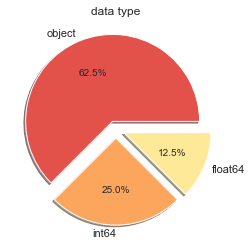

In [169]:
test.dtypes.value_counts().plot.pie(explode=[0.1,0.1,0.1],autopct='%1.1f%%',shadow=True)
plt.title('data type');

Observation:
 * Datatypes are int,float and object.Object columns need to be encoded to numerical columns before modelling.

In [170]:
train_date_min = train['Date'].min()
train_date_max = train['Date'].max()
print('Minimum date from training set: {}'.format(train_date_min))
print('Maximum date from training set: {}'.format(train_date_max))

Minimum date from training set: 2020-01-23
Maximum date from training set: 2020-06-10


Observation:
 * Training dataset has records from 23-01-2020 to 10-06-2020

In [172]:
test_date_min = test['Date'].min()
test_date_max = test['Date'].max()
print('Minimum date from test set: {}'.format(test_date_min))
print('Maximum date from test set: {}'.format(test_date_max))

Minimum date from test set: 2020-04-27
Maximum date from test set: 2020-06-10


Observation:
 * Training dataset has records from 27-04-2020 to 10-06-2020

There is a date overlap between train and test set. We will handle this in data pre-processing section

### Inspecting Categorical Columns

In [173]:
# checking training dataset
catColumn=train.select_dtypes(include=['object'])
for col in catColumn:    
    print(train[col].value_counts())

Washington    8680
Jefferson     7280
Franklin      7000
Lincoln       6720
Jackson       6720
              ... 
Harford        280
Garrett        280
Charles        280
Cecil          280
Weston         280
Name: County, Length: 1840, dtype: int64
Texas                       71400
Georgia                     44800
Virginia                    37520
Kentucky                    33880
Missouri                    32760
                            ...  
Liaoning                      280
Jilin                         280
Jiangxi                       280
Jiangsu                       280
Turks and Caicos Islands      280
Name: Province_State, Length: 133, dtype: int64
US                895440
China               9520
Canada              3640
United Kingdom      3080
France              3080
                   ...  
Ghana                280
Greece               280
Grenada              280
Guatemala            280
Zimbabwe             280
Name: Country_Region, Length: 187, dtype: int64
2020-

Observation:
 * Date column need to be conveted to date datatype. We will extract date , month and year separately before modelling as          otherwise our model cannot infer anything if combined . 
 * Confirmed Cases and Fatalities from Target column will be encoded, same will do for other object column the date

In [174]:
# Check the data ditribution of categorical features
train.describe(include='object')

,County,Province_State,Country_Region,Date,Target
count,880040,917280,969640,969640,969640
unique,1840,133,187,140,2
top,Washington,Texas,US,2020-01-23,ConfirmedCases
freq,8680,71400,895440,6926,484820


Observation:
 * There are 187 country covid details in the training dataset
 * Most of Country_Region case are in US with 895440
 * Texas is the Province_State having most cases of 71400
 * Washington is the County haing most cases of 8680
 * Details of 140 different dates are available in training dataset
 * The most cases are for the date of 2020-01-23 with 6926
 * Target has most cases of ConfirmedCases with 484820

Let's check the details of object datatype in test dataset

In [175]:
# checking test dataset
catColumn=test.select_dtypes(include=['object'])
for col in catColumn:    
    print(train[col].value_counts())

Washington    8680
Jefferson     7280
Franklin      7000
Lincoln       6720
Jackson       6720
              ... 
Harford        280
Garrett        280
Charles        280
Cecil          280
Weston         280
Name: County, Length: 1840, dtype: int64
Texas                       71400
Georgia                     44800
Virginia                    37520
Kentucky                    33880
Missouri                    32760
                            ...  
Liaoning                      280
Jilin                         280
Jiangxi                       280
Jiangsu                       280
Turks and Caicos Islands      280
Name: Province_State, Length: 133, dtype: int64
US                895440
China               9520
Canada              3640
United Kingdom      3080
France              3080
                   ...  
Ghana                280
Greece               280
Grenada              280
Guatemala            280
Zimbabwe             280
Name: Country_Region, Length: 187, dtype: int64
2020-

Observation:
 * The datas are same as train dataset
 * we will do the same datatype conversion as we do in train

In [176]:
# Check the data ditribution of categorical features
test.describe(include='object')

,County,Province_State,Country_Region,Date,Target
count,282870,294840,311670,311670,311670
unique,1840,133,187,45,2
top,Washington,Texas,US,2020-04-27,ConfirmedCases
freq,2790,22950,287820,6926,155835


Observation:
 * 187 country wise information is available
 * Most of Country_Region case are in US with 287820
 * Texas is the Province_State having most cases of 22950
 * Washington is the County haing most cases of 2790
 * Details of 45 different dates are available in test dataset 
 * The most case are at the date of 2020-04-27 with 6926
 * Target has most cases of ConfirmedCases with 155835

### Inspecting Numerical Features

In [177]:
# Traing dataset
train.describe(exclude='object')

,Id,Population,Weight,TargetValue
count,969640.000000,9.696400e+05,969640.000000,969640.000000
mean,484820.500000,2.720127e+06,0.530870,12.563518
std,279911.101847,3.477771e+07,0.451909,302.524795
min,1.000000,8.600000e+01,0.047491,-10034.000000
25%,242410.750000,1.213300e+04,0.096838,0.000000
50%,484820.500000,3.053100e+04,0.349413,0.000000
75%,727230.250000,1.056120e+05,0.968379,0.000000
max,969640.000000,1.395773e+09,2.239186,36163.000000


In [178]:
# Traing dataset
test.describe(exclude='object')

,ForecastId,Population,Weight
count,311670.000000,3.116700e+05,311670.000000
mean,155835.500000,2.720127e+06,0.530870
std,89971.523537,3.477775e+07,0.451910
min,1.000000,8.600000e+01,0.047491
25%,77918.250000,1.213300e+04,0.096838
50%,155835.500000,3.053100e+04,0.349413
75%,233752.750000,1.056120e+05,0.968379
max,311670.000000,1.395773e+09,2.239186


### Check for duplicate values¶

In [179]:
#check train dataset
train.duplicated().any()

False

In [180]:
#check test dataset
test.duplicated().any()

False

Observation:
 * No duplicates in train and test dataset

### Missing Values

In [181]:
# Checking training datset
train.isnull().values.any()

True

In [182]:
# Checking test datset
test.isnull().values.any()

True

Observation:
 * There are missing values in training and test dataset. We will explore further to see which all columns are having null values

In [183]:
# Check missing value count per column for train dataset
missingCount = train.isnull().sum()
missing_pourcent = train.isnull().sum()/train.shape[0]*100

dic = {
    'mising':missingCount,
    'missing_pourcent %':missing_pourcent
}
df=pd.DataFrame(dic)
df

,mising,missing_pourcent %
Id,0,0.000000
County,89600,9.240543
Province_State,52360,5.399942
Country_Region,0,0.000000
Population,0,0.000000
Weight,0,0.000000
Date,0,0.000000
Target,0,0.000000
TargetValue,0,0.000000


In [184]:
# Check missing value count per column for test dataset
# Check missing value count per column for train dataset
missingCount = train.isnull().sum()
missing_pourcent = train.isnull().sum()/train.shape[0]*100

dic = {
    'mising':missingCount,
    'missing_pourcent %':missing_pourcent
}
df=pd.DataFrame(dic)
df

,mising,missing_pourcent %
Id,0,0.000000
County,89600,9.240543
Province_State,52360,5.399942
Country_Region,0,0.000000
Population,0,0.000000
Weight,0,0.000000
Date,0,0.000000
Target,0,0.000000
TargetValue,0,0.000000


Obsrvation:
 * Only County and Province_State are having missing values.

### Seeing the Correleation

<AxesSubplot:>

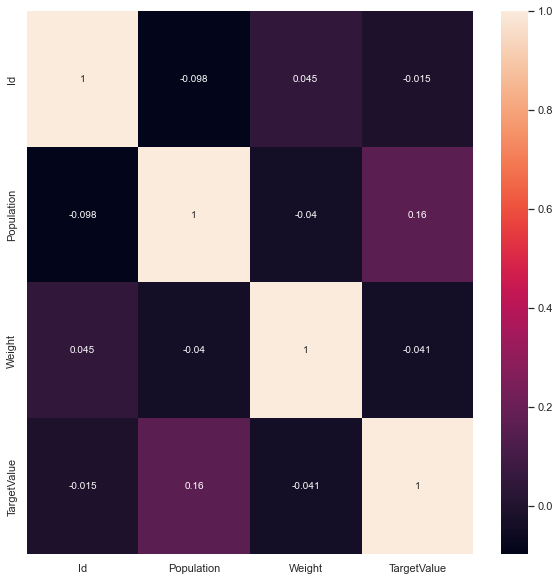

In [185]:
#Ploting the correlation matrix
plt.figure(figsize =(10,10))
sns.heatmap(train.corr(),annot=True)

Observation:
 * From the correlation matrix we can see that all of the features are weekly correlated

### Pairplot

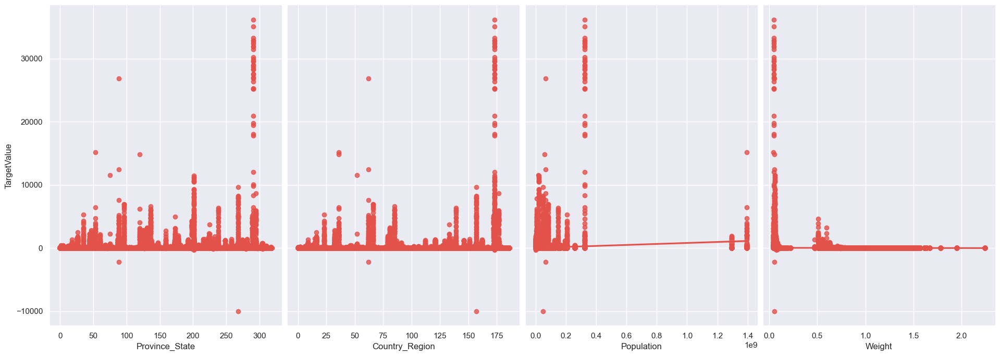

In [17]:
sns.pairplot(train, x_vars=['Province_State','Country_Region','Population','Weight'], y_vars='TargetValue', size=7, aspect=0.7, kind='reg')

Observation:
 * The independent variables are not linearly related to target variable , TargetValue

### Target Vs Target Value

<AxesSubplot:xlabel='Target', ylabel='TargetValue'>

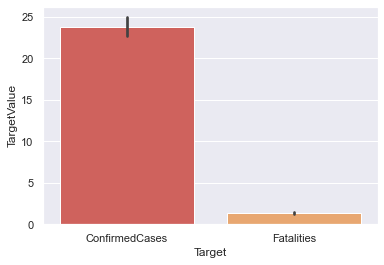

In [186]:
sns.barplot(x="Target",y="TargetValue",data=train)

Observation:

  * The traning dataset contains mainly confirmed cases than fatalities

### Graphical Analysis

Here we are going to do graphical analysis of train and test data to fetch more information from the dataset.

In [63]:
data = pd.read_csv('train.csv')
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date',inplace=True)

cases_data = data[(data['Target'] == 'ConfirmedCases')]
fatal_data = data[(data['Target'] == 'Fatalities')]

In [64]:

def find_top_n(df, column, topn):
    total = df.groupby([column])['TargetValue'].sum()
    top_n = total.sort_values(ascending = False)[:topn]
    top_n_countries = []
    for i in top_n.index:
        top_n_countries.append(i)
    return top_n_countries

cases_top_10 = find_top_n(cases_data,'Country_Region',10)
death_top_10 = find_top_n(fatal_data,'Country_Region',10)

In [65]:
print('Basic information from the data:')
print('----------------------------------------------')
print('1. Time')
print('Time range on training data:', data.index.min(),' - ',data.index.max())
print('Total days on training data:', data.index.nunique())
#print('Time range on test data:', test.index.min(),' - ',evaluate_data.index.max())
#print('Total days on test data:', test.index.nunique())
print('2. Countries')
print('The number of countries recorded:', data['Country_Region'].nunique())
print('Top 10 coutries that have most cases: ',cases_top_10)
print('Top 10 coutries that have most deaths: ',death_top_10)

Basic information from the data:
----------------------------------------------
1. Time
Time range on training data: 2020-01-23 00:00:00  -  2020-06-10 00:00:00
Total days on training data: 140
2. Countries
The number of countries recorded: 187
Top 10 coutries that have most cases:  ['US', 'Brazil', 'Russia', 'United Kingdom', 'India', 'Spain', 'Italy', 'Peru', 'Canada', 'France']
Top 10 coutries that have most deaths:  ['US', 'United Kingdom', 'Brazil', 'Italy', 'France', 'Spain', 'Canada', 'Mexico', 'Belgium', 'China']


### Visualization on Hotspot Countries

#### 1. The number of cases and deaths in each country over time

In [67]:
# let's see which country are not in case top10 but in death top10
t_countries = []
for i in death_top_10:
    if i not in cases_top_10:
        t_countries.append(i)
    else:
        pass
# We will add them in as hotspot countries
hotspots = cases_top_10+t_countries

In [68]:
cases_by_country = cases_data[['Country_Region','TargetValue']].reset_index()
cases_by_country = cases_by_country.groupby(['Date','Country_Region'])['TargetValue'].sum().unstack()
cases_df = cases_by_country[hotspots]

deaths_by_country = fatal_data[['Country_Region','TargetValue']].reset_index()
deaths_by_country = deaths_by_country.groupby(['Date','Country_Region'])['TargetValue'].sum().unstack()
deaths_df = deaths_by_country[hotspots]

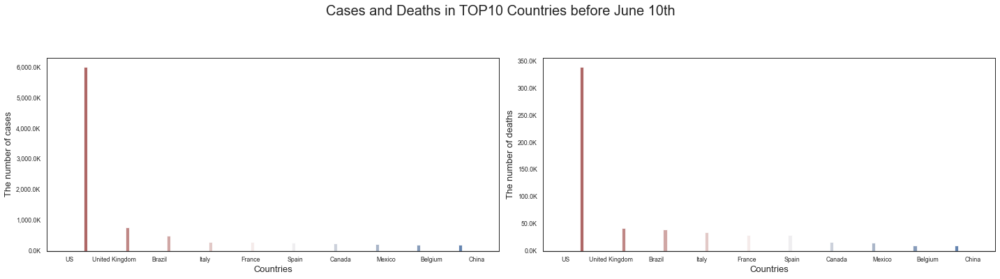

In [193]:
sns.set_context("paper")
sns.set_style("white")
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,5), sharex=True)
f.suptitle('Cases and Deaths in TOP10 Countries before June 10th',fontsize = 20,y=1.1)

sns.barplot(x=cases_top_10, y=cases_by_country[cases_top_10].sum().values,
            hue =cases_by_country[cases_top_10].sum().values,
            palette = "vlag", ax = ax1)
ax1.set_xlabel('Countries', size=13)
ax1.axhline(0, color="k", clip_on=False)
ax1.set_ylabel('The number of cases', size=13)
ylabels = ['{:,.1f}'.format(x) + 'K' for x in ax1.get_yticks()/1000]
ax1.set_yticklabels(ylabels)
ax1.legend_.remove()

sns.barplot(x=death_top_10,y= deaths_by_country[death_top_10].sum().values,
            hue =deaths_by_country[death_top_10].sum().values,
            palette = "vlag", ax = ax2)

ax2.set_xlabel('Countries', size=13)
ax2.axhline(0, color="k", clip_on=False)
ax2.set_ylabel('The number of deaths', size=13)
ylabels2 = ['{:,.1f}'.format(x) + 'K' for x in ax2.get_yticks()/1000]
ax2.set_yticklabels(ylabels2)
ax2.legend_.remove()

# Finalize the plot
plt.tight_layout()

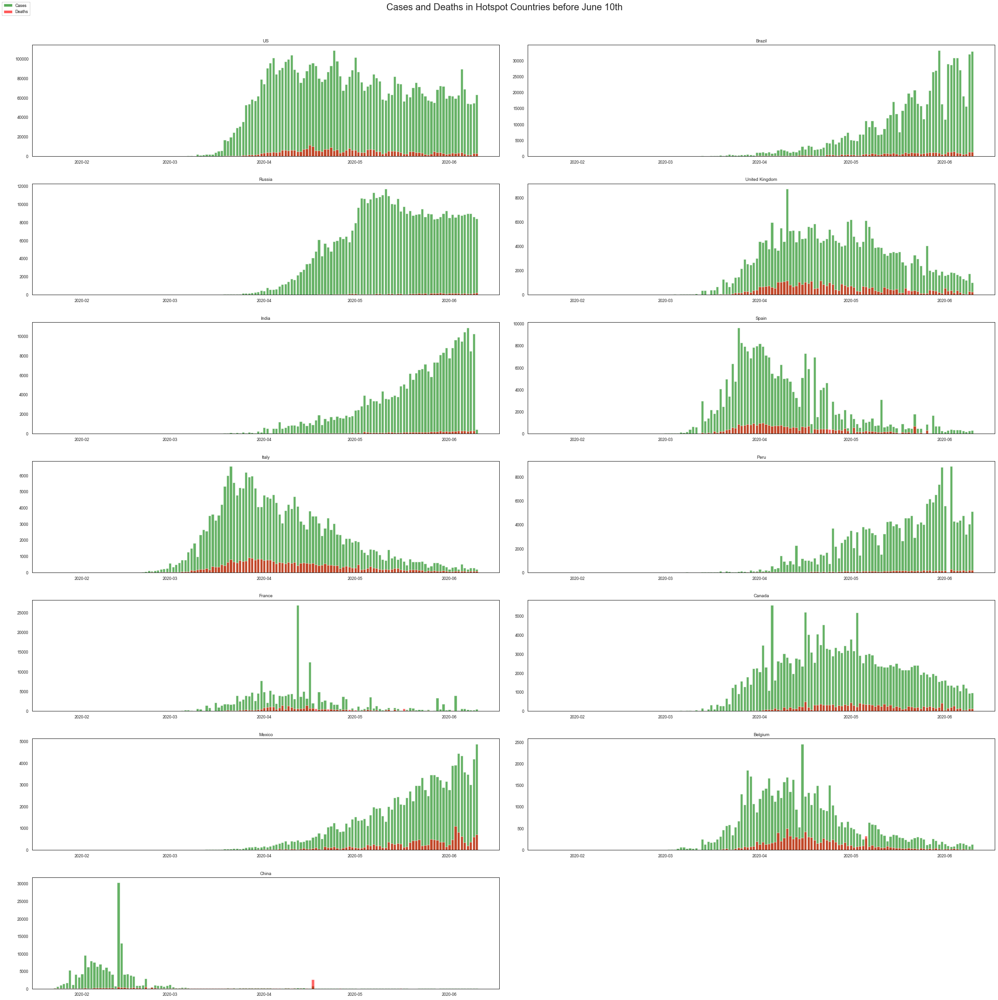

In [194]:
fig = plt.figure(figsize= (30,30))
plt.suptitle('Cases and Deaths in Hotspot Countries before June 10th',fontsize = 20,y=1.0)
for i in range(13):
    ax = fig.add_subplot(7,2,i+1)
    ax.bar(cases_df.index,cases_df.iloc[:,i],color = 'green',alpha = 0.6, label = 'Cases');
    ax.bar(deaths_df.index,deaths_df.iloc[:,i],color = 'red',alpha = 0.6, label = 'Deaths');
    plt.title(hotspots[i])
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper left')
plt.tight_layout(pad=3.0)

#### 2. The percentage of cases over population in each country over time

We know that the severity of covid spead is associate with the percentage value over the total population, so we will also visualize the proportion of cases over the total population for each country.

In [334]:
pct_by_country = cases_data[['Country_Region','Population','TargetValue']].reset_index()
cases_calculate = pct_by_country.groupby(['Date','Country_Region'])['TargetValue'].sum().unstack()
population_calculate = pct_by_country.groupby(['Date','Country_Region'])['Population'].max().unstack()
pct_by_country = (cases_calculate/population_calculate)*100
pct_df = pct_by_country[hotspots]

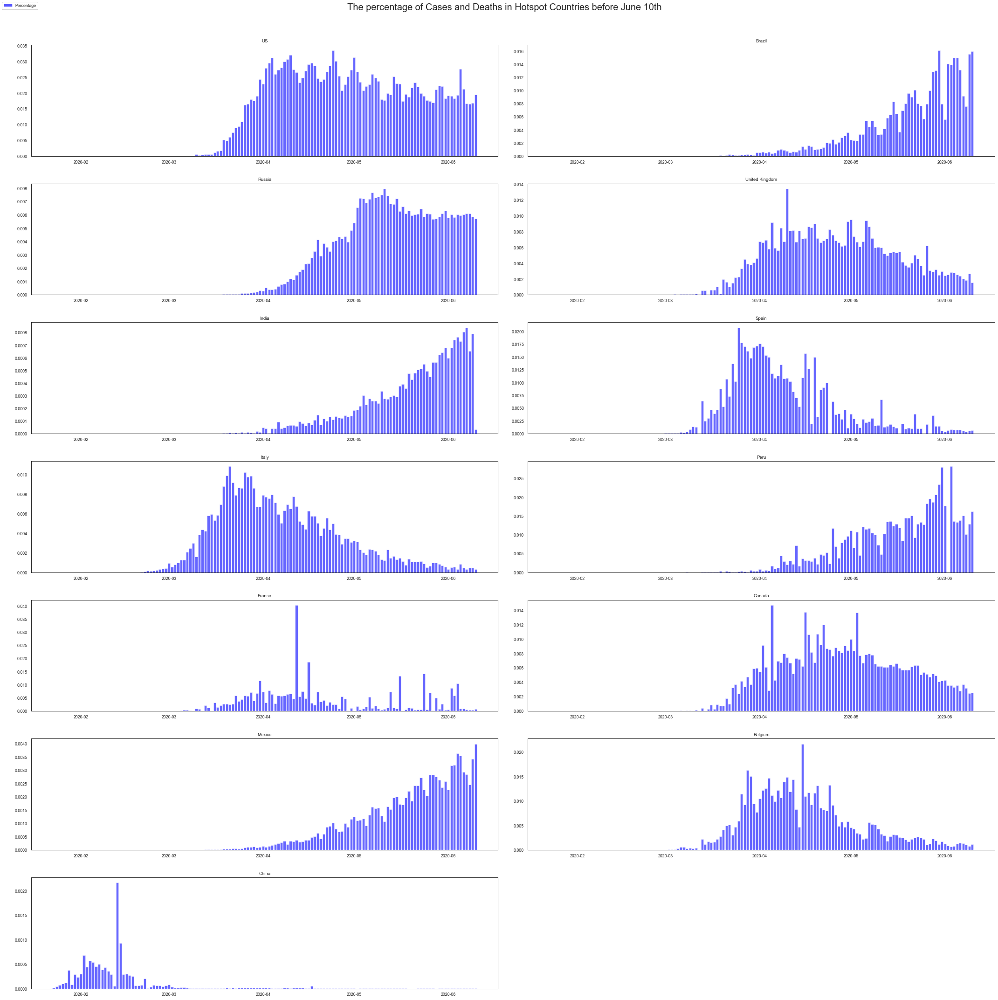

In [335]:
fig = plt.figure(figsize= (30,30))
plt.suptitle('The percentage of Cases and Deaths in Hotspot Countries before June 10th',fontsize = 20,y=1.0)
for i in range(13):
    ax = fig.add_subplot(7,2,i+1)
    ax.bar(pct_df.index,pct_df.iloc[:,i],color = 'blue',alpha = 0.6, label = 'Percentage');
    plt.title(hotspots[i])
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper left')
plt.tight_layout(pad=3.0)

##### Let's visualize the top 15 infected countries using barplot

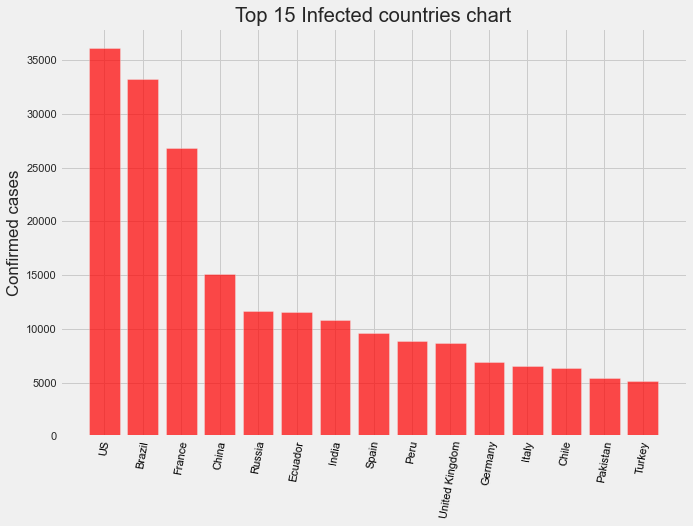

In [78]:
#GETTING TOP 15 INFECTED COUNTRIES(CONFIRMED CASES)
confirmed=train[train['Target']=='ConfirmedCases']
train_max_confirmed=pd.DataFrame()
train_max_confirmed['Confirmed_cases']  = confirmed.groupby('Country_Region')['TargetValue'].max().sort_values(ascending=False)
plot_confirmed= train_max_confirmed.head(15)

plt.style.use("fivethirtyeight")
fig,ax= plt.subplots(figsize=(10,7))
ax.bar(plot_confirmed.index, plot_confirmed['Confirmed_cases'],color='r',label='Confirmed cases',width=0.8,alpha=0.7)
ax.set_xticklabels(train_max_confirmed.index,rotation=80,color='black')
ax.set_ylabel('Confirmed cases')
ax.set_title('Top 15 Infected countries chart')
plt.show()

##### PLOTTING THE TOP 15 COUNTRIES WITH MAXIMUM FATALITIES

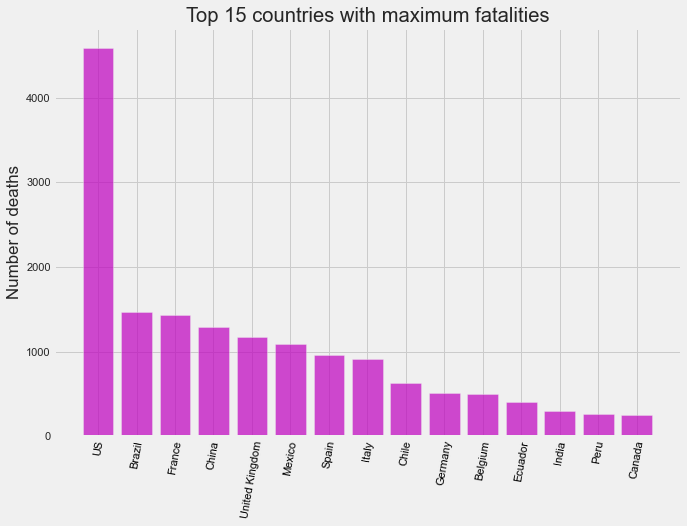

In [14]:
fatalities=train[train['Target']!='ConfirmedCases']
train_max_deaths=pd.DataFrame()
train_max_deaths['Fatalities']  = fatalities.groupby('Country_Region')['TargetValue'].max().sort_values(ascending=False)

plot_confirmed1= train_max_deaths.head(15)
plt.style.use("fivethirtyeight")
fig,ax= plt.subplots(figsize=(10,7))
ax.bar(plot_confirmed1.index, plot_confirmed1['Fatalities'],color='m',label='Deaths',width=0.8,alpha=0.7)
ax.set_xticklabels(plot_confirmed1.index,rotation=80,color='black')
ax.set_ylabel('Number of deaths')
ax.set_title('Top 15 countries with maximum fatalities')
plt.show()

Observation:
  * From the above graphs for confirmed and fatalities, we can say that US has most Confirmed cases and followed by Brazil. The     virus has began at China but virus is showing a greater impact on US and Brazil than China

###  Visualize the columns

Now let's visualize the columns using graph

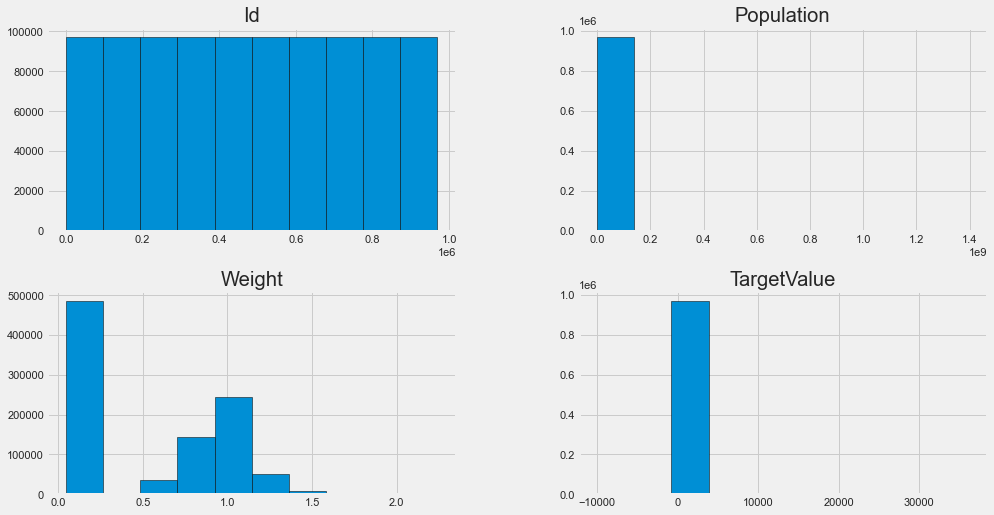

In [32]:
train.hist(figsize=(15,8),edgecolor='black');

##### TargetValue

  0%|                                                                                           | 0/63 [00:00<…


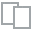
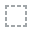
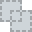
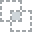
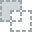
...
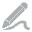
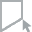
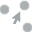
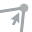
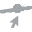

In [98]:
plot(train.TargetValue)

#####  County

  0%|                                                                                           | 0/42 [00:00<…


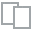
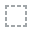
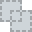
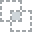
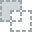
...
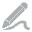
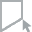
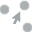
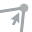
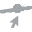

In [99]:
plot(train.County)

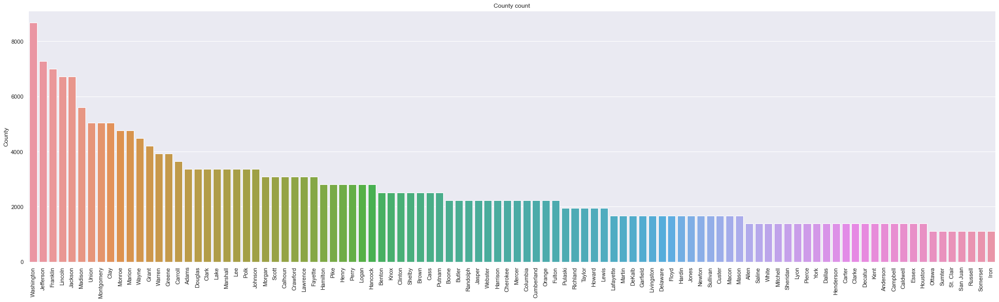

In [43]:
plt.figure(figsize=(30,9))
county_plot=train.County.value_counts().head(100)
sns.barplot(x=county_plot.index,y=county_plot)
plt.xticks(rotation=90)
plt.title('County count');



##### Province_State

  0%|                                                                                           | 0/42 [00:00<…


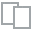
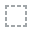
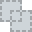
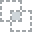
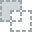
...
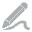
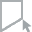
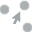
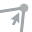
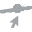

In [100]:
plot(train.Province_State)

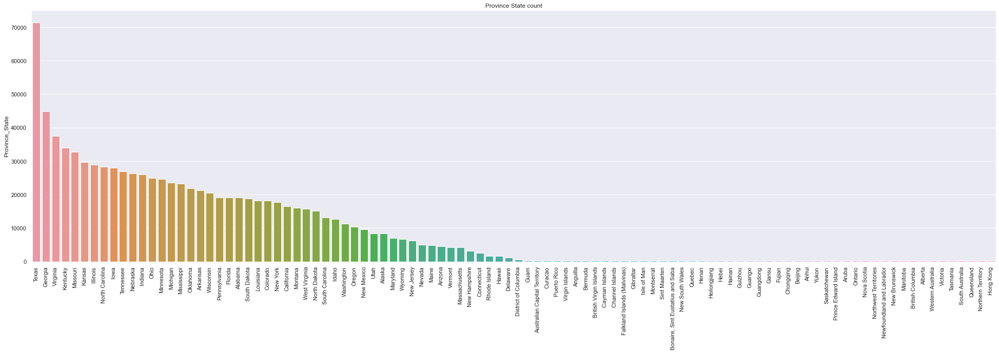

In [45]:
plt.figure(figsize=(30,9))
Province_State_plot=train.Province_State.value_counts().head(100)
sns.barplot(x=Province_State_plot.index,y=Province_State_plot)
plt.xticks(rotation=90)
plt.title('Province State count');

#### Country_Region

  0%|                                                                                           | 0/42 [00:00<…


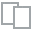
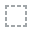
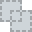
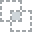
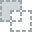
...
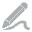
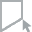
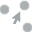
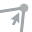
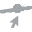

In [101]:
plot(train.Country_Region)

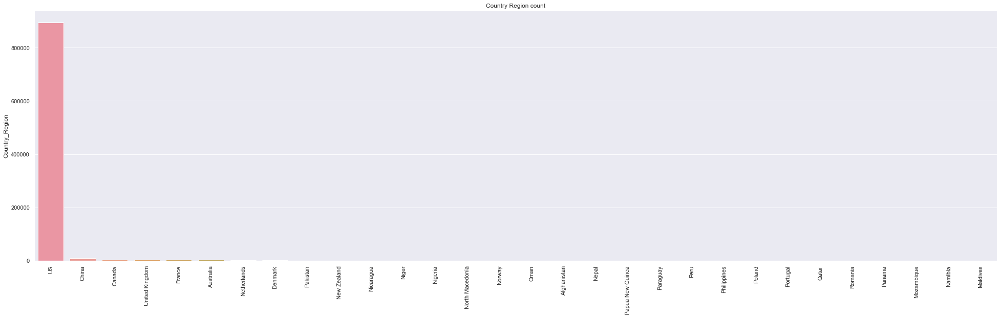

In [47]:
plt.figure(figsize=(30,9))
Country_Region_plot=train.Country_Region.value_counts().head(30)
sns.barplot(x=Country_Region_plot.index,y=Country_Region_plot)
plt.xticks(rotation=90)
plt.title('Country Region count');

### Data Pre-Processing

#### Handle Missing Values

Let's check the records which are not having missing values in County column

In [200]:
County_NoMissing=train[~train['County'].isnull()]
County_NoMissing['Country_Region'].unique()

array(['US'], dtype=object)

Observation:
 * As we can see above the available non null values for County column are  for US only. So we can drop this column before          prediction

In [201]:
County_NoMissing=train[~train['Province_State'].isnull()]
County_NoMissing['Country_Region'].unique()

array(['Australia', 'Canada', 'China', 'Denmark', 'France', 'Netherlands',
       'US', 'United Kingdom'], dtype=object)

Observation:
    * There are many countries having  Province_State data available in the training dataset. US ,China are some ofthe 
      countries having large geographical area, so dropping this column is not a good idea. We need to retain this data 
      for modelling.
    * We can replace the null value with the Country name for those null values columns

In [5]:
# Replacing all the  Province_State that are null by the Country_Region values

train.Province_State.fillna(train.Country_Region, inplace=True)
test.Province_State.fillna(test.Country_Region, inplace=True)

Dropping columns County, Id from training dataset and County,ForecastId from tesing dataset

In [6]:
train=train.drop(columns=['County','Id'])
test=test.drop(columns=['County','ForecastId'])

Let's check whether missing values are still there

In [204]:
train.isnull().values.any()

False

In [205]:
test.isnull().values.any()

False

Observation:
 * All missing values in training and test dataset are handled now

#### Handling Date Overlap

As we have identified a date overlap in training and test , we will handle here. The overlapped dates from train dataset will be removed.

In [7]:
test_date_min = test['Date'].min()
test_date_max = test['Date'].max()

def avoid_data_leakage(df, date=test_date_min):
    return df[df['Date']<date]

train_Full=train.copy()

before=train.shape[0]
print('No of records Before: {}'.format(train.shape[0]))

train=avoid_data_leakage(train)

after=train.shape[0]

print('No of records After: {}'.format(after))
print('Total records removed: {}'.format(before - after))

No of records Before: 969640
No of records After: 657970
Total records removed: 311670


In [8]:
train_date_min = train['Date'].min()
train_date_max = train['Date'].max()
print('Minimum date from train set: {}'.format(train_date_min))
print('Maximum date from train set: {}'.format(train_date_max))

Minimum date from train set: 2020-01-23
Maximum date from train set: 2020-04-26


In [57]:
test_date_min = test['Date'].min()
test_date_max = test['Date'].max()
print('Minimum date from test set: {}'.format(test_date_min))
print('Maximum date from test set: {}'.format(test_date_max))

Minimum date from test set: 2020-04-27
Maximum date from test set: 2020-06-10


Observation:
  * There were 311670 overlapped date records in training dataset which are removed now.
  * Now training dataset contains data from 2020-01-23 to 2020-04-26.
  * Now test dataset contains data from 2020-04-27 to 2020-06-10.


### Model Building

Here we will use different regression algorithms for prediction

The different types of regression models used in this notebook are
 * Decision Tree Regressor
 * Random Forest Regressor
 * Gradient Boosting Regressor
 * XGB Regressor
 * LGBM Regressor

In [209]:
# Check the datatype of training dataset
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 657970 entries, 0 to 969549
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Province_State  657970 non-null  object 
 1   Country_Region  657970 non-null  object 
 2   Population      657970 non-null  int64  
 3   Weight          657970 non-null  float64
 4   Date            657970 non-null  object 
 5   Target          657970 non-null  object 
 6   TargetValue     657970 non-null  int64  
dtypes: float64(1), int64(2), object(4)
memory usage: 40.2+ MB


We will convert the date column to date dataype

In [9]:
train['Date']=pd.to_datetime(train['Date'])
test['Date']=pd.to_datetime(test['Date'])

In [211]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 657970 entries, 0 to 969549
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Province_State  657970 non-null  object        
 1   Country_Region  657970 non-null  object        
 2   Population      657970 non-null  int64         
 3   Weight          657970 non-null  float64       
 4   Date            657970 non-null  datetime64[ns]
 5   Target          657970 non-null  object        
 6   TargetValue     657970 non-null  int64         
dtypes: datetime64[ns](1), float64(1), int64(2), object(3)
memory usage: 40.2+ MB


Algorithms cannot read anything from the date, so we extract various features from it, such as the day and week.

In [10]:
def extarct_features(df):
    df['day'] = df['Date'].dt.day
    df['month'] = df['Date'].dt.month
    return df

In [11]:
train=extarct_features(train)
test=extarct_features(test)

In [214]:
train.head(10)

,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue,day,month
0,Afghanistan,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0,23,1
1,Afghanistan,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0,23,1
2,Afghanistan,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0,24,1
3,Afghanistan,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0,24,1
4,Afghanistan,Afghanistan,27657145,0.058359,2020-01-25,ConfirmedCases,0,25,1
5,Afghanistan,Afghanistan,27657145,0.583587,2020-01-25,Fatalities,0,25,1
6,Afghanistan,Afghanistan,27657145,0.058359,2020-01-26,ConfirmedCases,0,26,1
7,Afghanistan,Afghanistan,27657145,0.583587,2020-01-26,Fatalities,0,26,1
8,Afghanistan,Afghanistan,27657145,0.058359,2020-01-27,ConfirmedCases,0,27,1
9,Afghanistan,Afghanistan,27657145,0.583587,2020-01-27,Fatalities,0,27,1


In [215]:
test.head(10)

,Province_State,Country_Region,Population,Weight,Date,Target,day,month
0,Afghanistan,Afghanistan,27657145,0.058359,2020-04-27,ConfirmedCases,27,4
1,Afghanistan,Afghanistan,27657145,0.583587,2020-04-27,Fatalities,27,4
2,Afghanistan,Afghanistan,27657145,0.058359,2020-04-28,ConfirmedCases,28,4
3,Afghanistan,Afghanistan,27657145,0.583587,2020-04-28,Fatalities,28,4
4,Afghanistan,Afghanistan,27657145,0.058359,2020-04-29,ConfirmedCases,29,4
5,Afghanistan,Afghanistan,27657145,0.583587,2020-04-29,Fatalities,29,4
6,Afghanistan,Afghanistan,27657145,0.058359,2020-04-30,ConfirmedCases,30,4
7,Afghanistan,Afghanistan,27657145,0.583587,2020-04-30,Fatalities,30,4
8,Afghanistan,Afghanistan,27657145,0.058359,2020-05-01,ConfirmedCases,1,5
9,Afghanistan,Afghanistan,27657145,0.583587,2020-05-01,Fatalities,1,5


Observation:
 * We have extracted new feature like day,month from date column
 * Now we can drop Date column before modelling

#### Encoding Object column

In [12]:
label = preprocessing.LabelEncoder()

train.Province_State = label.fit_transform(train.Province_State)
train.Country_Region = label.fit_transform(train.Country_Region)

test.Country_Region = label.fit_transform(test.Country_Region)
test.Province_State = label.fit_transform(test.Province_State)
test.head()

,Province_State,Country_Region,Population,Weight,Date,Target,day,month
0,0,0,27657145,0.058359,2020-04-27,ConfirmedCases,27,4
1,0,0,27657145,0.583587,2020-04-27,Fatalities,27,4
2,0,0,27657145,0.058359,2020-04-28,ConfirmedCases,28,4
3,0,0,27657145,0.583587,2020-04-28,Fatalities,28,4
4,0,0,27657145,0.058359,2020-04-29,ConfirmedCases,29,4


In [13]:
train.Target=label.fit_transform(train.Target)
test.Target=label.fit_transform(test.Target)

In [222]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 657970 entries, 0 to 969549
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Province_State  657970 non-null  int32  
 1   Country_Region  657970 non-null  int32  
 2   Population      657970 non-null  int64  
 3   Weight          657970 non-null  float64
 4   Target          657970 non-null  int32  
 5   TargetValue     657970 non-null  int64  
 6   day             657970 non-null  int64  
 7   month           657970 non-null  int64  
dtypes: float64(1), int32(3), int64(4)
memory usage: 37.6 MB


In [219]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 311670 entries, 0 to 311669
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Province_State  311670 non-null  int32         
 1   Country_Region  311670 non-null  int32         
 2   Population      311670 non-null  int64         
 3   Weight          311670 non-null  float64       
 4   Date            311670 non-null  datetime64[ns]
 5   Target          311670 non-null  int32         
 6   day             311670 non-null  int64         
 7   month           311670 non-null  int64         
dtypes: datetime64[ns](1), float64(1), int32(3), int64(3)
memory usage: 15.5 MB


Observation:
 * All object column are encoded
 * Train and test dataset has all numerical columns 

Dropping Date from training and test dataset

In [14]:
train = train.drop(['Date'],axis = 1)
test  = test.drop(['Date'],axis = 1)
train.head()

,Province_State,Country_Region,Population,Weight,Target,TargetValue,day,month
0,0,0,27657145,0.058359,0,0,23,1
1,0,0,27657145,0.583587,1,0,23,1
2,0,0,27657145,0.058359,0,0,24,1
3,0,0,27657145,0.583587,1,0,24,1
4,0,0,27657145,0.058359,0,0,25,1


In [37]:
test.head()

,Province_State,Country_Region,Population,Weight,Target,day,month
0,0,0,27657145,0.058359,0,27,4
1,0,0,27657145,0.583587,1,27,4
2,0,0,27657145,0.058359,0,28,4
3,0,0,27657145,0.583587,1,28,4
4,0,0,27657145,0.058359,0,29,4


### Split Data

Split train dataset into training set and test set in 70:30 proportion

In [20]:
Y = train.pop('TargetValue')
X = train

In [19]:
train.head()

,Province_State,Country_Region,Population,Weight,Target,TargetValue,day,month
0,0,0,27657145,0.058359,0,0,23,1
1,0,0,27657145,0.583587,1,0,23,1
2,0,0,27657145,0.058359,0,0,24,1
3,0,0,27657145,0.583587,1,0,24,1
4,0,0,27657145,0.058359,0,0,25,1


In [21]:
X_train,X_test, Y_train,Y_test = train_test_split(X,Y, test_size = 0.3,random_state =7)
X_train.describe()

,Province_State,Country_Region,Population,Weight,Target,day,month
count,460579.000000,460579.000000,4.605790e+05,460579.000000,460579.000000,460579.000000,460579.000000
mean,181.514209,166.128814,2.685169e+06,0.530728,0.499764,16.045371,2.777691
std,83.906564,28.383671,3.466169e+07,0.451917,0.500000,8.777083,0.953029
min,0.000000,0.000000,8.600000e+01,0.047491,0.000000,1.000000,1.000000
25%,127.000000,173.000000,1.213300e+04,0.096888,0.000000,8.000000,2.000000
50%,181.000000,173.000000,3.047900e+04,0.194712,0.000000,16.000000,3.000000
75%,265.000000,173.000000,1.050890e+05,0.968257,1.000000,24.000000,4.000000
max,318.000000,186.000000,1.395773e+09,2.239186,1.000000,31.000000,4.000000


### Model Fitting

In [53]:
modelCollectionObj={
      "DecisionTree":DecisionTreeRegressor(),
      "RandomForest":RandomForestRegressor(n_estimators = 100, random_state = 0),
      "GradientBoost":GradientBoostingRegressor(),
      "XGBoost":xgb.XGBRegressor(verbosity=0),
      "LightGBM":ltb.LGBMRegressor()}

In [54]:
# Fit the model after scaling
def fit_model(modelObj):
    fittedModel={}
    modelResult=pd.DataFrame()
    for modelName,model in modelObj.items():
        
        pipeline = Pipeline([('scaler2' , StandardScaler()),
                        (modelName+':', model)])
        pipeline.fit(X_train , Y_train)
        
        fittedModel.update({modelName:model})
        
        YTrain_Predict=pipeline.predict(X_train)
        YTest_Predict=pipeline.predict(X_test)
        
        m_dict={}
        m_dict["1:Algorithm"] = modelName
        m_dict["2:MSE_Train"] = round(mean_squared_error(Y_train,YTrain_Predict),2)
        m_dict["3:MSE_Test"] = round(mean_squared_error(Y_test,YTest_Predict),2)
        m_dict["4:MAE_Train"] = round(mean_absolute_error(Y_train,YTrain_Predict),2)
        m_dict["5:MAE_Test"] = round(mean_absolute_error(Y_test,YTest_Predict),2)
        m_dict["6:Accuracy"] = round(pipeline.score(X_test, Y_test),2)
        modelResult=modelResult.append(m_dict,ignore_index=True)
        
    return fittedModel,modelResult

Fit the model

In [55]:
fModel,mResult=fit_model(modelCollectionObj)
mResult

,1:Algorithm,2:MSE_Train,3:MSE_Test,4:MAE_Train,5:MAE_Test,6:Accuracy
0,DecisionTree,0.00,4728.59,0.00,2.94,0.90
1,RandomForest,865.76,2854.12,1.03,2.54,0.94
2,GradientBoost,13638.16,11062.96,8.75,8.69,0.77
3,XGBoost,1408.22,2794.76,3.33,4.15,0.94
4,LightGBM,5205.42,4087.36,4.85,5.09,0.92


In [56]:
mResult.sort_values(by=['3:MSE_Test'],ascending=True)

,1:Algorithm,2:MSE_Train,3:MSE_Test,4:MAE_Train,5:MAE_Test,6:Accuracy
3,XGBoost,1408.22,2794.76,3.33,4.15,0.94
1,RandomForest,865.76,2854.12,1.03,2.54,0.94
4,LightGBM,5205.42,4087.36,4.85,5.09,0.92
0,DecisionTree,0.00,4728.59,0.00,2.94,0.90
2,GradientBoost,13638.16,11062.96,8.75,8.69,0.77


Observation:
 * Of all the regressor algorithm used for prediction , from the above table we can see that XGBoost has very good MSE Test score   having accuracy of 94 %

In [58]:
fModel

{'DecisionTree': DecisionTreeRegressor(),
 'RandomForest': RandomForestRegressor(random_state=0),
 'GradientBoost': GradientBoostingRegressor(),
 'XGBoost': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...),
 'LightGBM': LGBMRegressor()}

#### Prediction using best model for Test data

In [42]:
model_final=fModel.get('XGBoost')
pred_Final=model_final.predict(test)

In [45]:
output= pd.DataFrame({'Id':test_Timeseries.ForecastId , 'TargetValue':pred_Final})
output

,Id,TargetValue
0,1,97.157631
1,2,161.158432
2,3,97.157631
3,4,161.158432
4,5,97.157631
...,...,...
311665,311666,2027.877686
311666,311667,1969.061279
311667,311668,2027.877686
311668,311669,1969.061279


In [46]:
a=output.groupby(['Id'])['TargetValue'].quantile(q=0.05).reset_index()
b=output.groupby(['Id'])['TargetValue'].quantile(q=0.5).reset_index()
c=output.groupby(['Id'])['TargetValue'].quantile(q=0.95).reset_index()

In [47]:
a.columns=['Id','q0.05']
b.columns=['Id','q0.5']
c.columns=['Id','q0.95']
a=pd.concat([a,b['q0.5'],c['q0.95']],1)
a['q0.05']=a['q0.05']
a['q0.5']=a['q0.5']
a['q0.95']=a['q0.95']

In [50]:
# Creating submission file
sub=pd.melt(a, id_vars=['Id'], value_vars=['q0.05','q0.5','q0.95'])
sub['variable']=sub['variable'].str.replace("q","", regex=False)
sub['ForecastId_Quantile']=sub['Id'].astype(str)+'_'+sub['variable']
sub['TargetValue']=sub['value']
sub=sub[['ForecastId_Quantile','TargetValue']]
sub.reset_index(drop=True,inplace=True)
sub.to_csv("submission.csv",index=False)
sub.head()

,ForecastId_Quantile,TargetValue
0,1_0.05,97.157631
1,2_0.05,161.158432
2,3_0.05,97.157631
3,4_0.05,161.158432
4,5_0.05,97.157631


# Time Series Analysis

Here we will do time series analysis

A time series is a sequence where a metric is recorded over regular time intervals. Time series Analysis is the preparatory step before we develop a forecast of the series.Time series analysis involves understanding various aspects about the inherent nature of the series so that you are better informed to create meaningful and accurate forecasts. 

The following are the steps we do in this section

1. EDA - Understand the time series patterns.
    How to explore the basic patterns (seasonal or trends) of the COVID19 cases and deaths.

2. Construct the (S)ARIMA Models and Forecast.
    How to tune the hyperparameters of (S)ARIMA Model.
    How to evaluate the selected (S)ARIMA results.

ARIMA stands for AutoRegressive (AR) Integrated (I) Moving Average (MA). The provided data as input must be an univariate series, since ARIMA calculates future datapoints from the past.

ARIMA basically has three important parameters:

p: The autoregressive part of the model. Simplified one can say that the model assumes that if there were many confirmed cases yesterday and the day before, there will be many confirmed cases today and tomorrow.

d: The integrated part of the model that describes the amount of differentiation. If the available data are not stationary and contain trends, ARIMA can extract this seasonality.

q: The moving average part of the model. By forming moving averages, random effects can be smoothed.

In [80]:
data = train_Timeseries.copy()
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date',inplace=True)
data.head()

,Id,County,Province_State,Country_Region,Population,Weight,Target,TargetValue
Date,,,,,,,,
2020-01-23,1,NaN,NaN,Afghanistan,27657145,0.058359,ConfirmedCases,0
2020-01-23,2,NaN,NaN,Afghanistan,27657145,0.583587,Fatalities,0
2020-01-24,3,NaN,NaN,Afghanistan,27657145,0.058359,ConfirmedCases,0
2020-01-24,4,NaN,NaN,Afghanistan,27657145,0.583587,Fatalities,0
2020-01-25,5,NaN,NaN,Afghanistan,27657145,0.058359,ConfirmedCases,0


#### Here we will be considering the time series analysis and forecast for India.

Let's extract the Confimed cases and Fatalities separately. 

In [81]:
cases_India = data[(data['Target'] == 'ConfirmedCases') & (data['Country_Region'] == 'India')]
deaths_India = data[(data['Target'] == 'Fatalities') & (data['Country_Region'] == 'India')]
cases_India.head()

,Id,County,Province_State,Country_Region,Population,Weight,Target,TargetValue
Date,,,,,,,,
2020-01-23,40321,NaN,NaN,India,1295210000,0.04766,ConfirmedCases,0
2020-01-24,40323,NaN,NaN,India,1295210000,0.04766,ConfirmedCases,0
2020-01-25,40325,NaN,NaN,India,1295210000,0.04766,ConfirmedCases,0
2020-01-26,40327,NaN,NaN,India,1295210000,0.04766,ConfirmedCases,0
2020-01-27,40329,NaN,NaN,India,1295210000,0.04766,ConfirmedCases,0


In [82]:
# two time series for the ConfirmedCases and Fatalities in the India
cases_India = cases_India.groupby(level = 'Date')['TargetValue'].sum()
deaths_India= deaths_India.groupby(level = 'Date')['TargetValue'].sum()
df = cases_India.to_frame()
df = df.rename(columns = {'TargetValue': 'Cases'})
df['Deaths'] = deaths_India

In [7]:
df.shape

(140, 2)

Observagtion:
 * Currently we have 140 observation for confirmed Cases for India 

### EDA - Understand the time series patterns

### 1. Visualize data

* Here we will visualize data to identify trends and seasonality
* We will plot Decomposition

#### Visualizing the time series for cases and fatalities

<AxesSubplot:xlabel='Date', ylabel='Cases'>

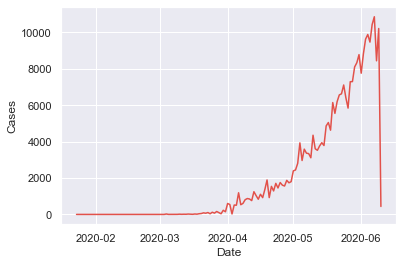

In [8]:
#Let’s use lineplot to visualise the series.
sns.lineplot(x="Date", y="Cases",legend = 'full' , data=df)

<AxesSubplot:xlabel='Date', ylabel='Deaths'>

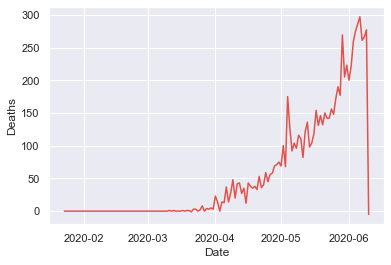

In [9]:
#Let’s use lineplot to visualise the series.
sns.lineplot(x="Date", y="Deaths",legend = 'full' , data=df)

Observation:
 * From the above graph we can observe an upward trend for cases and fatalities from April onwards
 * Eventhough the virus started in China in dec 2019 ,the graph till mid of march is flat for India , which indicate no covid    reported till that time, it could be because people started getting aware of the virus spreading from then and also tests might have started properly to predict the cases.

We will first compute the moving average of the time series for a window of 7 days and std deviation and plot on graph.
It will smooth the data allowing the viewer to infer some visible patterns or trends.

In [83]:
# Fucntion to plot rolling mean and std deviation for window of 7
def plot_graph(timeseries,win):
    rollMean=timeseries.rolling(window=win).mean()
    rollstd=timeseries.rolling(window=win).std()
    orig=plt.plot(timeseries,label='Original')
    mean=plt.plot(rollMean,label='Rolling mean')
    std=plt.plot(rollstd,label='Rolling std')

    plt.legend(loc='best')
    plt.title('Time series data with rolling mean and std dev (Window={})'.format(win))
    plt.show()

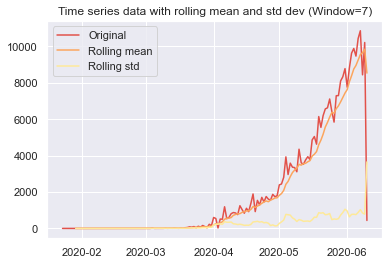

In [84]:
# Plot for confirmed Cases
plot_graph(df['Cases'],7)
df['cases_7_rolling'] = df['Cases'].rolling(7).mean().dropna()

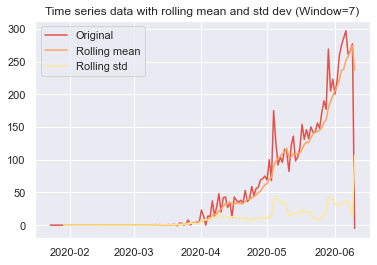

In [85]:
# Plot for fatalities
plot_graph(df['Deaths'],7)
df['deaths_7_rolling'] = df['Deaths'].rolling(7).mean().dropna()

Observation:
 * From both the graph, we can observe that the rolling mean has a trend component
 * Rolling standard deviation is fairly constant with time
 * Both time series of cases and deaths grew exponentially from April. 
 * For our time series to be stationary , we need to ensure that the rolling statistics (mean and std) remain time invariant or 
   constant with time.

 Let's use the decomposition function to see if there is any seasonal trend.

#### Decomposition

<Figure size 432x288 with 0 Axes>

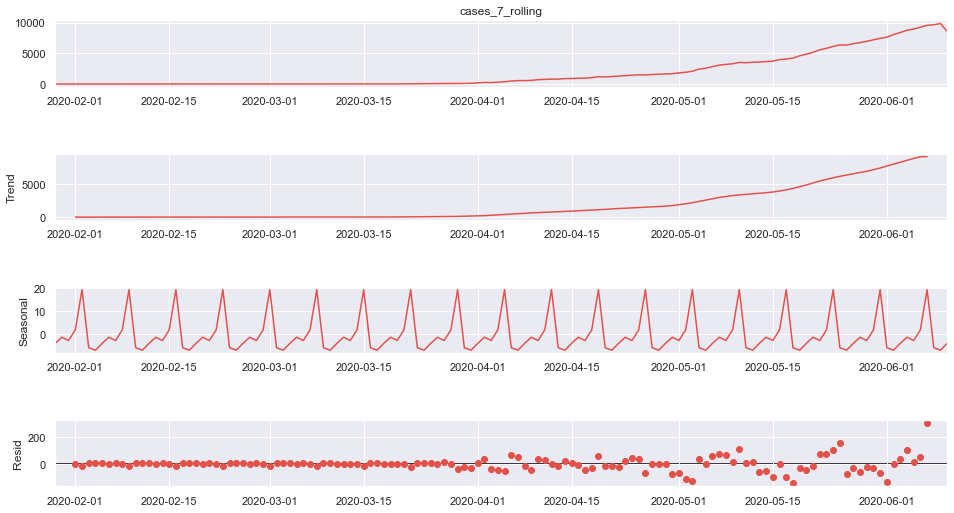

In [11]:
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(df['cases_7_rolling'].dropna())  
fig = plt.figure()  
fig = decomposition.plot()  
fig.set_size_inches(15, 8)

<Figure size 432x288 with 0 Axes>

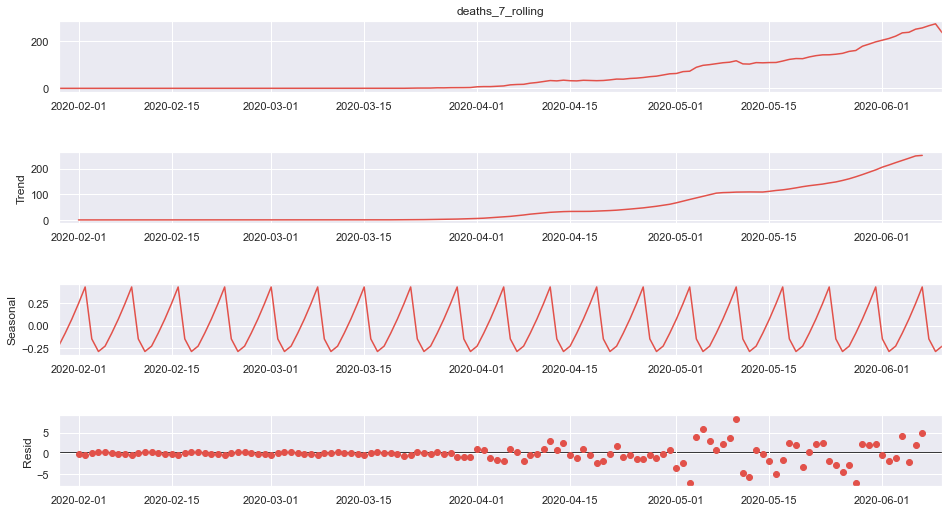

In [12]:
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(df['deaths_7_rolling'].dropna())  
fig = plt.figure()  
fig = decomposition.plot()  
fig.set_size_inches(15, 8)

Observation:
 * In both time series of the number of cases and deaths in the India, there is a clear upward trend .
 * We can also see that there is a clear seasonal pattern in the data, with peaks and troughs occurring at regular intervals.
 * The residual component of the plot suggests that there may be other factors that are not captured by the trend and seasonal      components that are impacting the spread of the virus.

### 2. Make the time series data stationary

In order to make accurate prediction in time series data, it is important to first make the data stationary. This means removing any trends or seasonal patterns from the data so that it is more predictable.There are several methods for making time series data stationary, including:
* Differencing
* Log transformation
* Moving average
* Decomposition
* Stationarity test(Augmented Dickey-Fuller test or the Kwiatkowski-Phillips-Schmidt-Shin test.).


The ADF test is used to test the null hypothesis that a time series has a unit root (i.e. it is non-stationary) against the alternative hypothesis that it is stationary. If the null hypothesis is rejected, it suggests that the time series is stationary and can be used in forecasting models.

Here we will use Augmented Dickey-Fuller test(ADF) to test stationary.

In [86]:
# Function to perform ADF test for checking for stationary
def adcf_test(timeseries): 
    #plot_graph(timeseries,7)
    
    dftest=adfuller(timeseries, autolag='AIC')
    print('Augmented Dickey-Fuller Test:')
    dfoutput=pd.Series(dftest[0:4],index=['The test statistic','MacKinnon’s approximate p-value','The number of lags','The number of observations'])
    print(dfoutput)
    
    if dftest[1] <= 0.05:
        print("strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")
    

In [87]:
adcf_test(df['cases_7_rolling'].dropna())

Augmented Dickey-Fuller Test:
The test statistic                  -4.550159
MacKinnon’s approximate p-value      0.000159
The number of lags                  13.000000
The number of observations         120.000000
dtype: float64
strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root and is stationary


Observation:
 * Confirmed cases data is having p-value on ADF test 0.000159 < 0.05 , thus it rejects the null hypothesis and thus data is        stationary now.

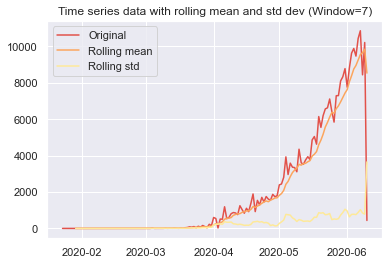

In [88]:
plot_graph(df['Cases'],7)

Observation:
  Eventhough ADF Test has tested stationary , on ploting the series we can see that the timeseries not stationary yet.
  We will try to make stationary using differencing method

In [89]:
# First difference
df['Cases first difference'] = df['cases_7_rolling'] - df['cases_7_rolling'].shift(1)
adcf_test(df['Cases first difference'].dropna())

Augmented Dickey-Fuller Test:
The test statistic                  -2.216603
MacKinnon’s approximate p-value      0.200275
The number of lags                  13.000000
The number of observations         119.000000
dtype: float64
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


In [90]:
# First difference
df['Cases second difference'] = df['Cases first difference'] - df['Cases first difference'].shift(1)
adcf_test(df['Cases second difference'].dropna())

Augmented Dickey-Fuller Test:
The test statistic                  -1.986254
MacKinnon’s approximate p-value      0.292633
The number of lags                  13.000000
The number of observations         118.000000
dtype: float64
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Observation:
 * Differencing has no effecting in making this series as stationary
 * We will try using log method and rolling mean method

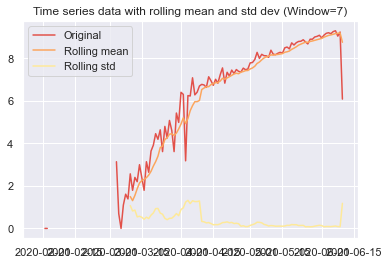

In [92]:
df['Cases Log']=np.log(df['Cases'])
plot_graph(df['Cases Log'].dropna(),7)

Observation:

 * Log operation also didn't give stationary dataset
 We will now try rolling mean method

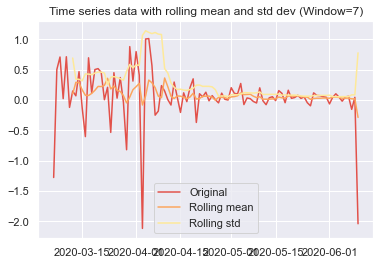

Augmented Dickey-Fuller Test:
The test statistic                 -3.410426
MacKinnon’s approximate p-value     0.010609
The number of lags                  4.000000
The number of observations         92.000000
dtype: float64
strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root and is stationary


In [93]:
ma= df['Cases Log'].rolling(3).mean().dropna()
df['Cases Log Ma']=df['Cases Log'] - ma
plot_graph(df['Cases Log Ma'].dropna(),7)
adcf_test(df['Cases Log Ma'].dropna())

Observation:
   * Now our timeseries data from confirmed cases is stationary

Let's try making fatalities timeseries data stationary

In [94]:
adcf_test(df['deaths_7_rolling'].dropna())

Augmented Dickey-Fuller Test:
The test statistic                   0.332865
MacKinnon’s approximate p-value      0.978803
The number of lags                   8.000000
The number of observations         125.000000
dtype: float64
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Observation:
 * This data is not stationary as p-value is greater that 0.05 in the ADF test

#### Make the fatalities time series stationary

In [95]:
# First difference
df['Death first difference'] = df['deaths_7_rolling'] - df['deaths_7_rolling'].shift(1)
adcf_test(df['Death first difference'].dropna())

Augmented Dickey-Fuller Test:
The test statistic                  -2.806168
MacKinnon’s approximate p-value      0.057398
The number of lags                   7.000000
The number of observations         125.000000
dtype: float64
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


In [96]:
# Second difference
df['Death second difference'] = df['Death first difference'] - df['Death first difference'].shift(1)
adcf_test(df['Death second difference'].dropna())

Augmented Dickey-Fuller Test:
The test statistic                  -3.157681
MacKinnon’s approximate p-value      0.022569
The number of lags                   6.000000
The number of observations         125.000000
dtype: float64
strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root and is stationary


<AxesSubplot:xlabel='Date'>

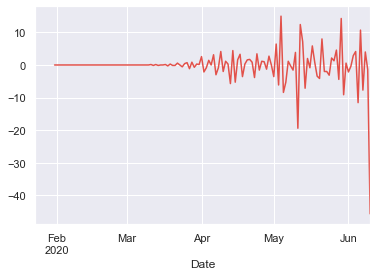

In [97]:
df['Death second difference'].plot()

Observation:
    * Timeseries data fro fatalities is now stationary after taking difference two times

#### Plot the AutoCorrelation(ACF) and Partial Autocorrelation(PACF)

In time series we use previous data points (lags as we call them) to predict what will happen next. These plots help us determine what are likely to be the most important lags.

ACF: The correlation between the observations at the current point in time and the observations at all previous points in time. We can use ACF to determine the optimal number of MA terms.

PACF:PACF expresses the correlation between observations made at two points in time while accounting for any influence from other data points. We can use PACF to determine the optimal number of terms to use in the AR model.

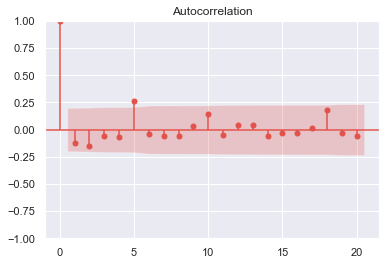

In [98]:
acf_cases = plot_acf(df['Cases Log Ma'].dropna())

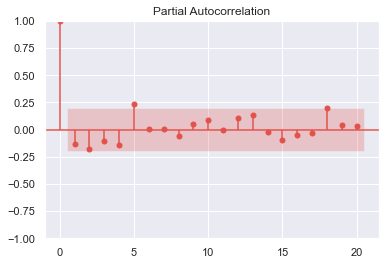

In [25]:
pacf_cases = plot_pacf(df['Cases Log Ma'].dropna())

Observation:
 The pacf plot has a sharp drop at lag 1, which suggests that the time series is possibly a AR(2).

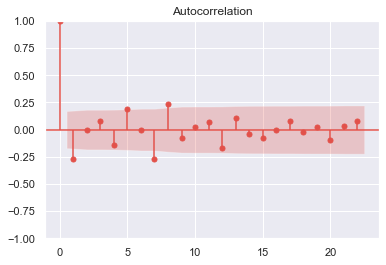

In [26]:
acf_deaths = plot_acf(df['Death second difference'].dropna())

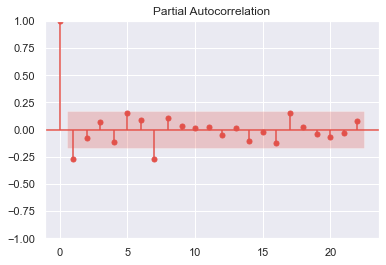

In [27]:
pacf_death = plot_pacf(df['Death second difference'].dropna())

### Construct the (S)ARIMA Models and Forecast

Now we can use ARIMA model

The parameters fro this model are p,d,q :

 * p: The number of lag observations included in the model.
 * d: The number of times that the raw observations are differenced, also called the degree of differencing.
 * q: The size of the moving average window, also called the order of moving average.

#### ARIMA model for confirmed cases

First try: ARIMA model for confirmed cases

In [99]:
# evaluate an ARIMA model for a given order (p,d,q)

## Using root mean quared error metric
def rmse(test, pred):
    mse=mean_squared_error(test, pred)
    return sqrt(mean_squared_error(test, pred))

## Using mean absolute percentage error metric:
def mape(test, pred):
    test, pred = np.array(test), np.array(pred)
    return np.mean(np.abs((test - pred)/test))*100

def arima_model(X, arima_order):
    # prepare training dataset
    train_size = int(len(X) * 0.8)
    train, test = X[0:train_size], X[train_size:]
    history = [x for x in train]
    # make predictions
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=arima_order)
        model_fit = model.fit()
        yhat = model_fit.forecast()[0]
        predictions.append(yhat)
        history.append(test[t])
    return test, predictions

In [157]:
# evaluate combinations of p, d and q values for an ARIMA model

def GridSearch_arima(dataset, p_values, d_values, q_values):
    
    #We will choose the arima model that has the lowest MSE
    
    dataset = dataset.astype('float32')
    best_score, best_cfg = float("inf"), None
    for p in p_values:
        for d in d_values:
            for q in q_values:
                order = (p,d,q)
                try:
                    result=arima_model(dataset, order)
                    mse = mean_squared_error(result[0], result[1])
                    if mse < best_score:
                        best_score, best_cfg = mse, order
                except:
                    continue
    print('Best ARIMA %s MSE=%.3f' % (best_cfg, best_score))

In [102]:
# evaluate parameters
p_values = range(0, 7)
d_values = range(0, 3)
q_values = range(0, 7)

In [184]:
GridSearch_arima(df['Cases Log Ma'].dropna().values, p_values, d_values, q_values)

Best ARIMA(5, 2, 0) MSE=0.203


In [103]:
dataset=df['Cases Log Ma'].dropna()

# split to train and test set (*80% for training and 20% for test)
trainset,testset=train_test_split(dataset,test_size=0.20,shuffle=False)

In [220]:
testset.head()
# start 2020-05-22

Date
2020-05-22    0.075285
2020-05-23    0.025491
2020-05-24    0.050062
2020-05-25   -0.045471
2020-05-26   -0.096639
Name: Cases Log Ma, dtype: float64

In [221]:
testset.tail()
# end 2020-06-10 

Date
2020-06-06    0.050416
2020-06-07    0.059074
2020-06-08   -0.154823
2020-06-09    0.043209
2020-06-10   -2.037671
Name: Cases Log Ma, dtype: float64

Observation:
 * Test data range is from '2020-05-22', '2020-06-10'

Test MSE 0.19278


Text(0.5, 1.0, 'Forecasting Result using ARIMA')

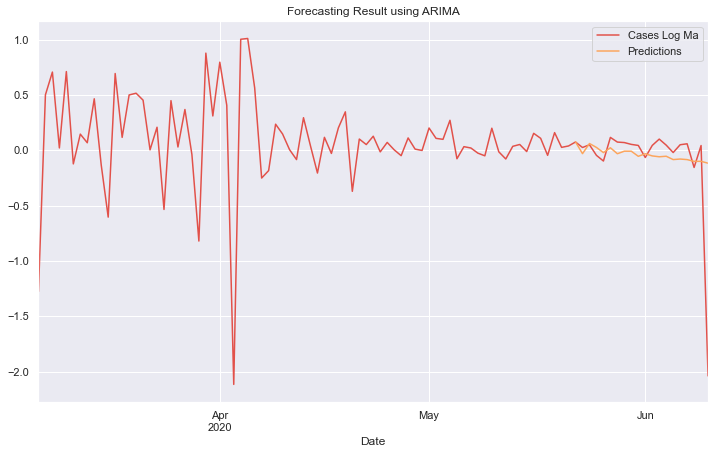

In [104]:
# perform ARIMA
model = ARIMA(trainset, order=(5, 2, 0))
model_ARIMA_fit = model.fit()
predictions = model_ARIMA_fit.predict('2020-05-22', '2020-06-10').rename("Predictions") 

mse = mean_squared_error(testset, predictions)

print('Test MSE %0.5f' % mse)

predict=np.exp(predictions)
test_set=np.exp(testset)

plt.figure(figsize = [12,7])
dataset.plot(legend = True)
predictions.plot(legend = True) 
plt.title('Forecasting Result using ARIMA')

In [105]:
# Evaluation
print('RMSE: {}'.format(rmse(testset,predictions.values)))
print('MAPE: {}'.format(mape(testset,predictions.values)))

RMSE: 0.4390667771161401
MAPE: 153.0960772596329


Observation:
 * ARIMA model RMSE is 0.44 and MAPE is 153.09

Let's try to plot the residuals

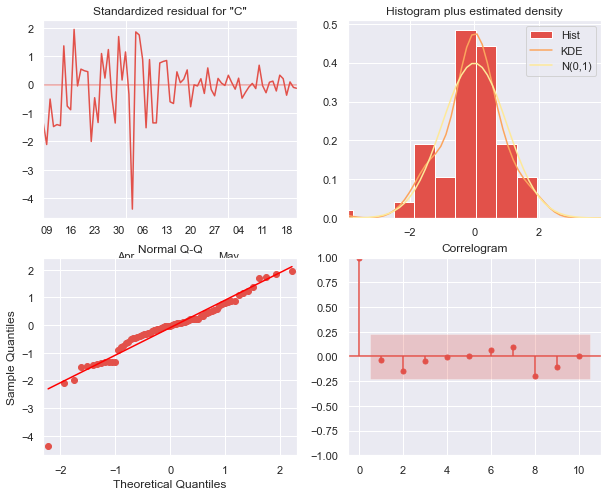

In [108]:
model_ARIMA_fit.plot_diagnostics(figsize=(10,8))
plt.show()

Observation:
 * Top left graph shows the residual errors seem to fluctuate around a mean of zero
 * The density plot suggest normal distribution with mean zero.
 * All the dots fall perfectly in line with the red line.

Overall, it seems to be a good fit.

#### ARIMA model for fatalities

In [132]:
# evaluate parameters
p_values = range(0, 7)
d_values = range(0, 3)
q_values = range(0, 7)

In [133]:
GridSearch_arima(df['Death second difference'].dropna().values, p_values, d_values, q_values)

Best ARIMA(5, 1, 4) MSE=83.026


In [134]:
# run the selected model
dataset_fat=df['Death second difference'].dropna()

# split to trin and test set (*80% for training and 20% for test)
trainset_Fat,testset_Fat=train_test_split(dataset_fat,test_size=0.20,shuffle=False)

In [139]:
# Checking the period of test dataset
print(testset_Fat.index[0],testset_Fat.index[-1])

2020-05-15 00:00:00 2020-06-10 00:00:00


Test MSE 114.83035


Text(0.5, 1.0, 'Forecasting Result using ARIMA')

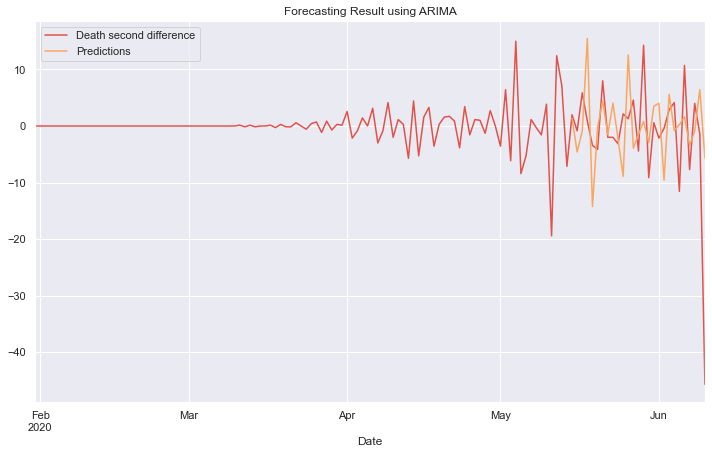

In [140]:
# perform ARIMA using best score
model_Fat = ARIMA(trainset_Fat, order=(5, 1, 4))
model_ARIMA_Fat_fit = model_Fat.fit()
predictions_fat = model_ARIMA_Fat_fit.predict('2020-05-15', '2020-06-10').rename("Predictions") 

mse = mean_squared_error(testset_Fat, predictions_fat)

print('Test MSE %0.5f' % mse)

plt.figure(figsize = [12,7])
dataset_fat.plot(legend = True)
predictions_fat.plot(legend = True) 
plt.title('Forecasting Result using ARIMA')

In [141]:
# Evaluation
print('RMSE: {}'.format(rmse(testset_Fat,predictions_fat.values)))
print('MAPE: {}'.format(mape(testset_Fat,predictions_fat.values)))

RMSE: 10.71589254772666
MAPE: 335.5155993639783


Let's try to plot the residuals

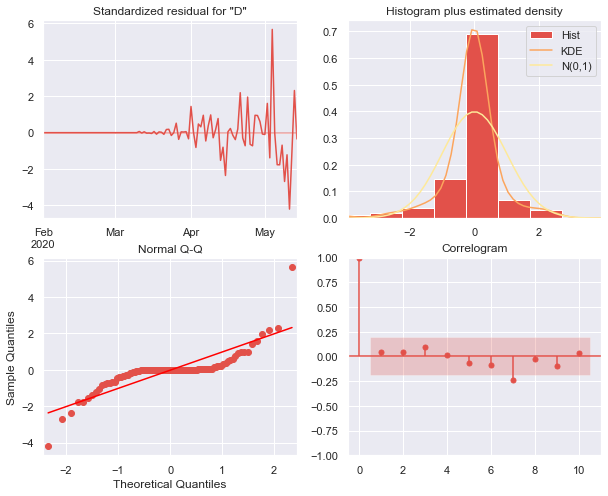

In [142]:
model_ARIMA_Fat_fit.plot_diagnostics(figsize=(10,8))
plt.show()

### SARIMA

SARIMA stands for Seasonal-ARIMA and it includes seasonality contribution to the forecast. 

#### Confirmed Cases

Here We use auto_arima() function from the pmdarima package, we can perform a parameter search for the optimal values of the model.

In [151]:
stepwise_fit = auto_arima(trainset, start_p=1, start_q=1, max_p=3, max_q=3, m=1,
                          start_P=0, seasonal=True, d=1, D=1, trace=True,
                          error_action='ignore',  # don't want to know if an order does not work
                          suppress_warnings=True,  # don't want convergence warnings
                          stepwise=True) 

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=156.541, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=141.575, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.12 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=154.594, Time=0.01 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=130.688, Time=0.03 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=127.047, Time=0.05 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.25 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.19 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=125.065, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=128.716, Time=0.03 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=92.378, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=94.611, Time=0.09 sec
 ARIMA(3,1,2)(0,0,0)[0]             : AIC=97.728, Time=0.14 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=97.758, Time=0.12 sec

B

In [152]:
print(stepwise_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                   77
Model:               SARIMAX(3, 1, 1)   Log Likelihood                 -41.189
Date:                Sat, 28 Jan 2023   AIC                             92.378
Time:                        16:56:37   BIC                            104.032
Sample:                    03-06-2020   HQIC                            97.035
                         - 05-21-2020                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3457      0.120     -2.872      0.004      -0.582      -0.110
ar.L2         -0.3923      0.105     -3.728      0.000      -0.599      -0.186
ar.L3         -0.2532      0.104     -2.438      0.0

In [153]:
# Fit the SARIMA model on train dataset with the best parameters
from statsmodels.tsa.statespace.sarimax import SARIMAX
model_SARIMAX = SARIMAX(trainset, order=stepwise_fit.order, seasonal_order=stepwise_fit.seasonal_order)
model_SARIMAX_fit = model_SARIMAX.fit()

In [154]:
#checking the timeperiod for test dataset
print(testset.index[0],testset.index[-1])

2020-05-22 00:00:00 2020-06-10 00:00:00


Mean Squared Error:  0.22611456719244952


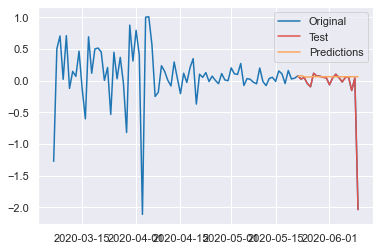

In [155]:
# Make predictions on the test set
predictions = model_SARIMAX_fit.predict(start=testset.index[0], end=testset.index[-1])

# Calculate the mean squared error of the predictions
mse = mean_squared_error(testset, predictions)
print("Mean Squared Error: ", mse)

# Plot the predicted and actual values
import matplotlib.pyplot as plt
plt.plot(df['Cases Log Ma'].dropna(), label='Original', color='#1f76b4')
plt.plot(testset, label='Test')
plt.plot(predictions, label='Predictions')
plt.legend(loc='best')
plt.show()

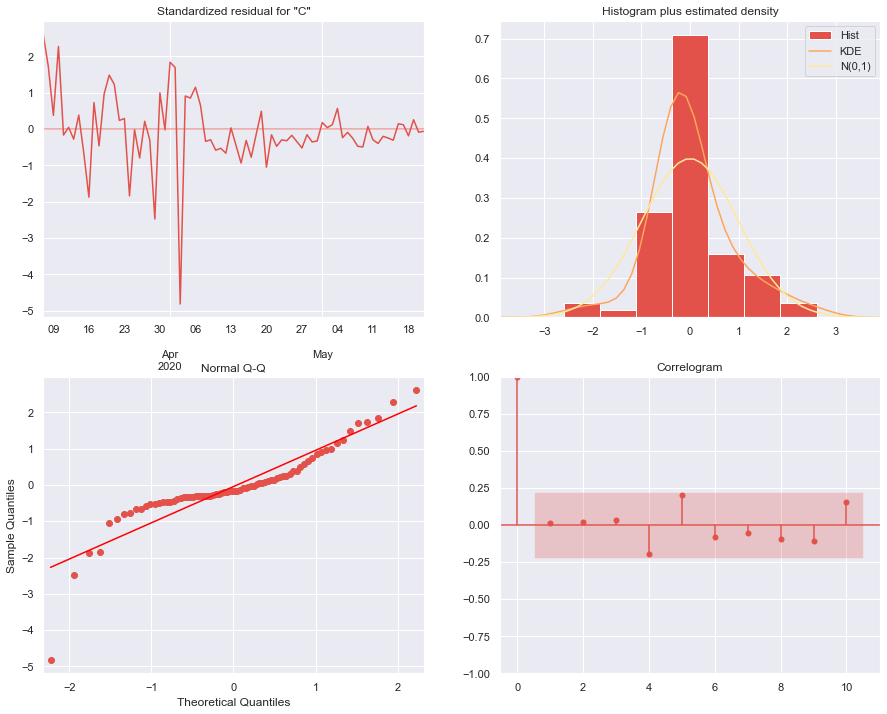

In [156]:
model_SARIMAX_fit.plot_diagnostics(figsize=(15,12))
plt.show()

Observation:
 * From the top left graph the residual errors does not fluctuate around a mean of zero and doesn't have a uniform variance.
 * Bottom left grapgh shows all point are not falling on the line, which means skewness is there
 
 So overall this SARIMA model does not outperform ARIMA model for predicting Confirmed cases

#### Fatalities

In [143]:
stepwise_Fat_fit = auto_arima(trainset_Fat, start_p=1, start_q=1, max_p=3, max_q=3, m=1,
                          start_P=0, seasonal=True, d=1, D=1, trace=True,
                          error_action='ignore',  # don't want to know if an order does not work
                          suppress_warnings=True,  # don't want convergence warnings
                          stepwise=True) 

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=673.377, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=619.584, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.11 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=671.390, Time=0.01 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=568.536, Time=0.04 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=563.604, Time=0.04 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.24 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.13 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=561.655, Time=0.03 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=566.603, Time=0.02 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=inf, Time=0.23 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=inf, Time=0.14 sec

Best model:  ARIMA(3,1,0)(0,0,0)[0]          
Total fit time: 1.183 seconds


In [144]:
print(stepwise_Fat_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  105
Model:               SARIMAX(3, 1, 0)   Log Likelihood                -276.827
Date:                Sat, 28 Jan 2023   AIC                            561.655
Time:                        16:40:23   BIC                            572.232
Sample:                    01-31-2020   HQIC                           565.940
                         - 05-14-2020                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.2686      0.066    -19.355      0.000      -1.397      -1.140
ar.L2         -0.9862      0.118     -8.362      0.000      -1.217      -0.755
ar.L3         -0.3269      0.115     -2.846      0.0

In [145]:
# Fit the SARIMA model on train dataset with the best parameters
model_SARIMAX_Fat = SARIMAX(trainset_Fat, order=stepwise_Fat_fit.order, seasonal_order=stepwise_Fat_fit.seasonal_order)
model_SARIMAX_Fat_fit = model_SARIMAX_Fat.fit()

In [146]:
#checking the timeperiod for test dataset
print(testset_Fat.index[0],testset_Fat.index[-1])

2020-05-15 00:00:00 2020-06-10 00:00:00


Mean Squared Error:  122.99414409968082


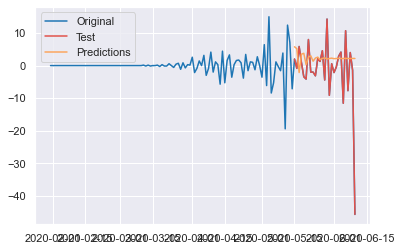

In [147]:
# Make predictions on the test set
predictions_Fat = model_SARIMAX_Fat_fit.predict(start=testset_Fat.index[0], end=testset_Fat.index[-1])

# Calculate the mean squared error of the predictions
mse = mean_squared_error(testset_Fat, predictions_Fat)
print("Mean Squared Error: ", mse)

# Plot the predicted and actual values
import matplotlib.pyplot as plt
plt.plot(dataset_fat, label='Original', color='#1f76b4')
plt.plot(testset_Fat, label='Test')
plt.plot(predictions_Fat, label='Predictions')
plt.legend(loc='best')
plt.show()

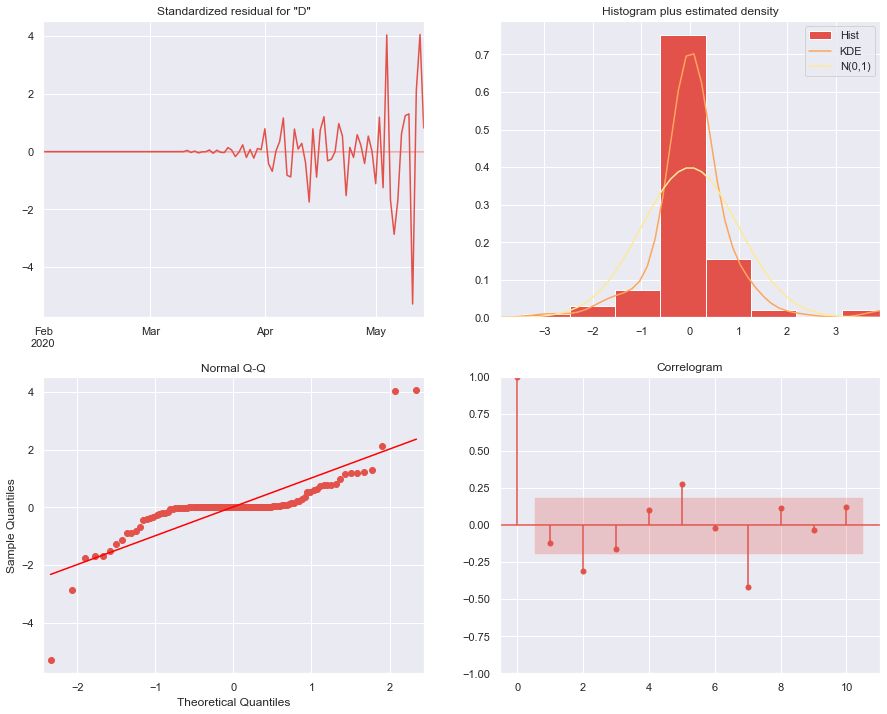

In [148]:
model_SARIMAX_Fat_fit.plot_diagnostics(figsize=(15,12))
plt.show()

Observation:
 * The SARIMAX model for fatalities prediction performance is not good as ARIMA model, as inferred from the graph.

We have identified that ARIMA model performs well for prediction, so we will use ARIMA model for forecasting for the given test dataset

### Forecasting for Confirmed covid cases using ARIMA model

We will use ARIMA model for future forecasting for confirmed cases with provided test dataset

In [125]:
# Checking the period of test dataset
print(test_Timeseries['Date'].min(),test_Timeseries['Date'].max())

2020-04-27 2020-06-10


 Forecasting for Confirmed covid cases using ARIMA model for date from 2020-04-27 to 2020-06-10

Text(0.5, 1.0, 'Forecasting Result using ARIMA for confirmed cases')

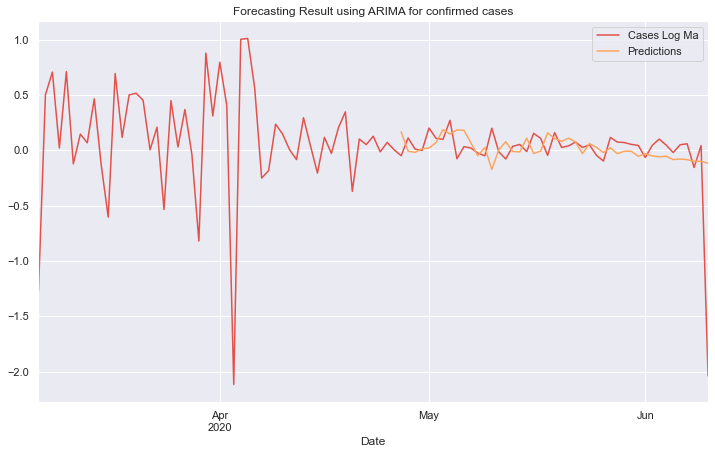

In [149]:
predictions = model_ARIMA_fit.predict('2020-04-27', '2020-06-10').rename("Predictions") 

plt.figure(figsize = [12,7])
dataset.plot(legend = True)
predictions.plot(legend = True) 
plt.title('Forecasting Result using ARIMA for confirmed cases')

### Forecasting for Fatalities cases using ARIMA model

 Forecasting for fatalities using ARIMA model for date from 2020-04-27 to 2020-06-10

Text(0.5, 1.0, 'Forecasting Result using ARIMA for Fatalities')

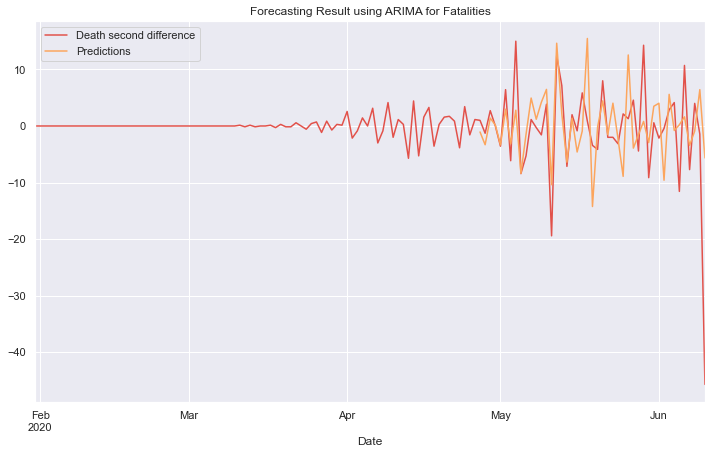

In [150]:
predictions_fat = model_ARIMA_Fat_fit.predict('2020-04-27', '2020-06-10').rename("Predictions") 

plt.figure(figsize = [12,7])
dataset_fat.plot(legend = True)
predictions_fat.plot(legend = True) 
plt.title('Forecasting Result using ARIMA for Fatalities')

# Conclusion

#### We have conducted a variety of statistical techniques, including time series analysis and supervised machine learning regression algorithms, to build models that could predict the number of confirmed cases and fatalities in different countries and regions.

#### The models were trained on historical data, including the number of confirmed cases and fatalities.Of all the models we have build for prediction XGBoost was showing good performance in terms of accuracy and MSE. Also in timeseries analysis ARIMA model performed well that SARIMA.

#### The models were then used to make predictions for the next several weeks as specified in the test dataset. The forecasts indicated that the number of confirmed cases and deaths would continue to rise in India till June. After that that the spread of the virus appeared to be slowing down.

#### Additionally, it is important to keep in mind that forecasting the spread of a disease like COVID-19 is a complex task and is subject to many uncertainties. The models used in this case are based on limited data and may not account for all factors that could affect the spread of the disease. Therefore, it is important to interpret the results with caution and use them in conjunction with other information and expert opinions. Overall, the models used in this case can provide valuable insights into the spread of the disease